# Auto Insurance Fraud

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
from scipy import stats
sns.set();

import warnings
warnings.filterwarnings('ignore') # Warnings are ignored with it. It is more visual. 

import matplotlib.pyplot as plt
%matplotlib inline
import missingno as msno

# Data Understanding and Data Preparation

https://www.kaggle.com/datasets/antopravinjohnbosco/auto-insurance-claims-fraud-detection

In [2]:
missing_value_formats = ["n.a.","?","NA","n/a", "na", "--"]
df = pd.read_csv('insurance fraud claims.csv', na_values = missing_value_formats)

In [3]:
df.head()

,months_as_customer,age,policy_number,policy_bind_date,policy_state,policy_csl,policy_deductable,policy_annual_premium,umbrella_limit,insured_zip,...,police_report_available,total_claim_amount,injury_claim,property_claim,vehicle_claim,auto_make,auto_model,auto_year,fraud_reported,_c39
0,328,48,521585,2014-10-17,OH,250/500,1000,1406.91,0,466132,...,YES,71610,6510,13020,52080,Saab,92x,2004,Y,NaN
1,228,42,342868,2006-06-27,IN,250/500,2000,1197.22,5000000,468176,...,NaN,5070,780,780,3510,Mercedes,E400,2007,Y,NaN
2,134,29,687698,2000-09-06,OH,100/300,2000,1413.14,5000000,430632,...,NO,34650,7700,3850,23100,Dodge,RAM,2007,N,NaN
3,256,41,227811,1990-05-25,IL,250/500,2000,1415.74,6000000,608117,...,NO,63400,6340,6340,50720,Chevrolet,Tahoe,2014,Y,NaN
4,228,44,367455,2014-06-06,IL,500/1000,1000,1583.91,6000000,610706,...,NO,6500,1300,650,4550,Accura,RSX,2009,N,NaN


In [4]:
df.columns

Index(['months_as_customer', 'age', 'policy_number', 'policy_bind_date',
       'policy_state', 'policy_csl', 'policy_deductable',
       'policy_annual_premium', 'umbrella_limit', 'insured_zip', 'insured_sex',
       'insured_education_level', 'insured_occupation', 'insured_hobbies',
       'insured_relationship', 'capital-gains', 'capital-loss',
       'incident_date', 'incident_type', 'collision_type', 'incident_severity',
       'authorities_contacted', 'incident_state', 'incident_city',
       'incident_location', 'incident_hour_of_the_day',
       'number_of_vehicles_involved', 'property_damage', 'bodily_injuries',
       'witnesses', 'police_report_available', 'total_claim_amount',
       'injury_claim', 'property_claim', 'vehicle_claim', 'auto_make',
       'auto_model', 'auto_year', 'fraud_reported', '_c39'],
      dtype='object')

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 40 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   months_as_customer           1000 non-null   int64  
 1   age                          1000 non-null   int64  
 2   policy_number                1000 non-null   int64  
 3   policy_bind_date             1000 non-null   object 
 4   policy_state                 1000 non-null   object 
 5   policy_csl                   1000 non-null   object 
 6   policy_deductable            1000 non-null   int64  
 7   policy_annual_premium        1000 non-null   float64
 8   umbrella_limit               1000 non-null   int64  
 9   insured_zip                  1000 non-null   int64  
 10  insured_sex                  1000 non-null   object 
 11  insured_education_level      1000 non-null   object 
 12  insured_occupation           1000 non-null   object 
 13  insured_hobbies    

Some columns considered not meaningful for the analyses are excluded from the dataset

In [6]:
to_drop = ['policy_number','policy_bind_date','insured_zip','incident_location',
           'incident_state','insured_hobbies','auto_make','auto_model', '_c39', "policy_csl"]

df.drop(to_drop, inplace = True, axis = 1)

The code below provides the counting of unique values within each categorical feature

In [7]:
for i in df.columns:
    if df[i].dtype == 'object':
        print(i,":", df[i].nunique())

policy_state : 3
insured_sex : 2
insured_education_level : 7
insured_occupation : 14
insured_relationship : 6
incident_date : 60
incident_type : 4
collision_type : 3
incident_severity : 4
authorities_contacted : 4
incident_city : 7
property_damage : 2
police_report_available : 2
fraud_reported : 2


In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 30 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   months_as_customer           1000 non-null   int64  
 1   age                          1000 non-null   int64  
 2   policy_state                 1000 non-null   object 
 3   policy_deductable            1000 non-null   int64  
 4   policy_annual_premium        1000 non-null   float64
 5   umbrella_limit               1000 non-null   int64  
 6   insured_sex                  1000 non-null   object 
 7   insured_education_level      1000 non-null   object 
 8   insured_occupation           1000 non-null   object 
 9   insured_relationship         1000 non-null   object 
 10  capital-gains                1000 non-null   int64  
 11  capital-loss                 1000 non-null   int64  
 12  incident_date                1000 non-null   object 
 13  incident_type      

In [9]:
df.describe()

,months_as_customer,age,policy_deductable,policy_annual_premium,umbrella_limit,capital-gains,capital-loss,incident_hour_of_the_day,number_of_vehicles_involved,bodily_injuries,witnesses,total_claim_amount,injury_claim,property_claim,vehicle_claim,auto_year
count,1000.000000,1000.000000,1000.000000,1000.000000,1.000000e+03,1000.000000,1000.000000,1000.000000,1000.00000,1000.000000,1000.000000,1000.00000,1000.000000,1000.000000,1000.000000,1000.000000
mean,203.954000,38.948000,1136.000000,1256.406150,1.101000e+06,25126.100000,-26793.700000,11.644000,1.83900,0.992000,1.487000,52761.94000,7433.420000,7399.570000,37928.950000,2005.103000
std,115.113174,9.140287,611.864673,244.167395,2.297407e+06,27872.187708,28104.096686,6.951373,1.01888,0.820127,1.111335,26401.53319,4880.951853,4824.726179,18886.252893,6.015861
min,0.000000,19.000000,500.000000,433.330000,-1.000000e+06,0.000000,-111100.000000,0.000000,1.00000,0.000000,0.000000,100.00000,0.000000,0.000000,70.000000,1995.000000
25%,115.750000,32.000000,500.000000,1089.607500,0.000000e+00,0.000000,-51500.000000,6.000000,1.00000,0.000000,1.000000,41812.50000,4295.000000,4445.000000,30292.500000,2000.000000
50%,199.500000,38.000000,1000.000000,1257.200000,0.000000e+00,0.000000,-23250.000000,12.000000,1.00000,1.000000,1.000000,58055.00000,6775.000000,6750.000000,42100.000000,2005.000000
75%,276.250000,44.000000,2000.000000,1415.695000,0.000000e+00,51025.000000,0.000000,17.000000,3.00000,2.000000,2.000000,70592.50000,11305.000000,10885.000000,50822.500000,2010.000000
max,479.000000,64.000000,2000.000000,2047.590000,1.000000e+07,100500.000000,0.000000,23.000000,4.00000,2.000000,3.000000,114920.00000,21450.000000,23670.000000,79560.000000,2015.000000


In [10]:
df.isnull().sum()

months_as_customer               0
age                              0
policy_state                     0
policy_deductable                0
policy_annual_premium            0
umbrella_limit                   0
insured_sex                      0
insured_education_level          0
insured_occupation               0
insured_relationship             0
capital-gains                    0
capital-loss                     0
incident_date                    0
incident_type                    0
collision_type                 178
incident_severity                0
authorities_contacted           91
incident_city                    0
incident_hour_of_the_day         0
number_of_vehicles_involved      0
property_damage                360
bodily_injuries                  0
witnesses                        0
police_report_available        343
total_claim_amount               0
injury_claim                     0
property_claim                   0
vehicle_claim                    0
auto_year           

In [11]:
df["insured_occupation"].unique()

array(['craft-repair', 'machine-op-inspct', 'sales', 'armed-forces',
       'tech-support', 'prof-specialty', 'other-service',
       'priv-house-serv', 'exec-managerial', 'protective-serv',
       'transport-moving', 'handlers-cleaners', 'adm-clerical',
       'farming-fishing'], dtype=object)

In [12]:
df["insured_relationship"].unique()

array(['husband', 'other-relative', 'own-child', 'unmarried', 'wife',
       'not-in-family'], dtype=object)

In [13]:
df["incident_type"].unique()

array(['Single Vehicle Collision', 'Vehicle Theft',
       'Multi-vehicle Collision', 'Parked Car'], dtype=object)

In [14]:
df["incident_severity"].unique()

array(['Major Damage', 'Minor Damage', 'Total Loss', 'Trivial Damage'],
      dtype=object)

In [15]:
df["authorities_contacted"].unique()

array(['Police', nan, 'Fire', 'Other', 'Ambulance'], dtype=object)

In [16]:
df.fraud_reported.value_counts(dropna=False)

fraud_reported
N    753
Y    247
Name: count, dtype: int64

In [17]:
df.property_damage.value_counts(dropna=False)

property_damage
NaN    360
NO     338
YES    302
Name: count, dtype: int64

In [18]:
df.police_report_available.value_counts(dropna=False)

police_report_available
NaN    343
NO     343
YES    314
Name: count, dtype: int64

In [19]:
df.incident_city.value_counts(dropna=False)

incident_city
Springfield    157
Arlington      152
Columbus       149
Northbend      145
Hillsdale      141
Riverwood      134
Northbrook     122
Name: count, dtype: int64

In [20]:
df["incident_date"].unique()

array(['2015-01-25', '2015-01-21', '2015-02-22', '2015-01-10',
       '2015-02-17', '2015-01-02', '2015-01-13', '2015-02-27',
       '2015-01-30', '2015-01-05', '2015-01-06', '2015-02-15',
       '2015-01-22', '2015-01-08', '2015-01-15', '2015-01-29',
       '2015-01-19', '2015-01-01', '2015-02-10', '2015-01-11',
       '2015-02-24', '2015-01-09', '2015-01-28', '2015-01-07',
       '2015-01-18', '2015-02-28', '2015-02-12', '2015-01-24',
       '2015-01-03', '2015-01-16', '2015-02-14', '2015-02-21',
       '2015-02-18', '2015-02-26', '2015-01-17', '2015-01-27',
       '2015-02-11', '2015-01-12', '2015-02-06', '2015-01-20',
       '2015-02-02', '2015-02-20', '2015-02-08', '2015-02-23',
       '2015-03-01', '2015-01-14', '2015-02-19', '2015-02-09',
       '2015-01-26', '2015-01-23', '2015-01-31', '2015-02-03',
       '2015-02-01', '2015-02-05', '2015-02-25', '2015-02-16',
       '2015-02-13', '2015-02-04', '2015-02-07', '2015-01-04'],
      dtype=object)

In [21]:
df["policy_state"].unique()

array(['OH', 'IN', 'IL'], dtype=object)

In [22]:
df[['collision_type', 'incident_severity']].head()

,collision_type,incident_severity
0,Side Collision,Major Damage
1,NaN,Minor Damage
2,Rear Collision,Minor Damage
3,Front Collision,Major Damage
4,NaN,Minor Damage


## Null values

A heatmap is displayed with the correlation between null values

A heatmap is displayed within the columns containing null values to identify potential correlations among them. Notably, the null values in the "collision type" column exhibit a strong correlation with the "authorities contacted" column. 

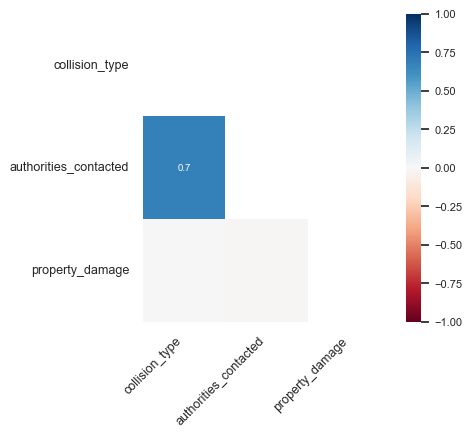

In [23]:
# Correlation between null values
ax = msno.heatmap(df[['collision_type', 'incident_severity', "authorities_contacted", "property_damage"]], figsize=(4, 4), fontsize=9)
cbar = ax.collections[0].colorbar
cbar.ax.tick_params(labelsize=8)
plt.show()

Given that 'authorities_contacted' contains 91 rows with null values and exhibits a strong correlation with null values in 'collision_type', it suggests that these rows may not provide meaningful insights. Therefore, they are dropped from the dataset.

In [24]:
df.dropna(subset=["authorities_contacted"], inplace=True)

Null values within the features 'collision_type', 'property_damage', and 'police_report_available' are filled with 'Unknown'. Given that the missing values are random and represent more than 15% of the data, filling them in with another variable may not be beneficial.

In [25]:
df[["collision_type", "property_damage", "police_report_available"]].fillna("Unknown", inplace=True)

## Date Type
The feature “incident_date” is transformed into a date type

In [26]:
df['incident_date']=pd.to_datetime(df['incident_date'], format='%Y-%m-%d')

df.head()

,months_as_customer,age,policy_state,policy_deductable,policy_annual_premium,umbrella_limit,insured_sex,insured_education_level,insured_occupation,insured_relationship,...,property_damage,bodily_injuries,witnesses,police_report_available,total_claim_amount,injury_claim,property_claim,vehicle_claim,auto_year,fraud_reported
0,328,48,OH,1000,1406.91,0,MALE,MD,craft-repair,husband,...,YES,1,2,YES,71610,6510,13020,52080,2004,Y
1,228,42,IN,2000,1197.22,5000000,MALE,MD,machine-op-inspct,other-relative,...,NaN,0,0,NaN,5070,780,780,3510,2007,Y
2,134,29,OH,2000,1413.14,5000000,FEMALE,PhD,sales,own-child,...,NO,2,3,NO,34650,7700,3850,23100,2007,N
3,256,41,IL,2000,1415.74,6000000,FEMALE,PhD,armed-forces,unmarried,...,NaN,1,2,NO,63400,6340,6340,50720,2014,Y
5,256,39,OH,1000,1351.10,0,FEMALE,PhD,tech-support,unmarried,...,NO,0,2,NO,64100,6410,6410,51280,2003,Y


## EDA

In [27]:
df_visua = pd.DataFrame(df).copy()

The visualization below enables the user to analyse the total claim amount by age and sex and select whether it was reported as fraud or not. We can notice that at some age there is a higher probability of being reported as fraudulent, for instance, those males in their 20s.

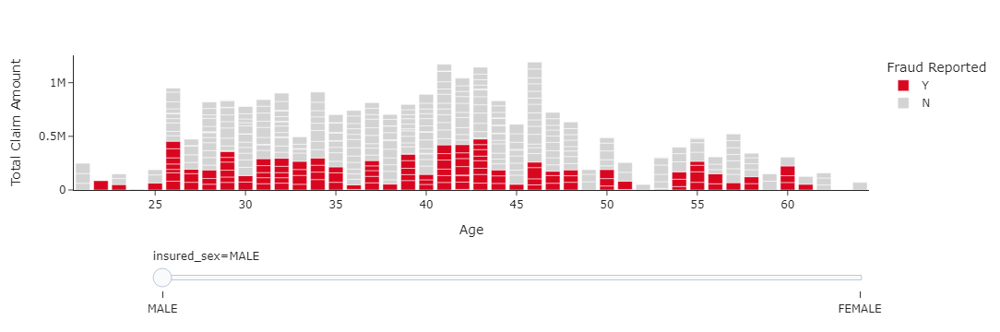

In [28]:
import plotly.express as px

# Define custom colors for the "Fraud Reported" variable
color_map = {
    "Y": "#D80720",
    "N": "lightgrey"
}

fig = px.bar(df, x="age", y="total_claim_amount", animation_frame="insured_sex",
             color="fraud_reported", color_discrete_map=color_map, template='simple_white',
             labels={"age": "Age", "total_claim_amount": "Total Claim Amount", "fraud_reported": "Fraud Reported"})

# Remove the default animation control buttons
fig["layout"].pop("updatemenus")

fig.show()


Utilizing a dashboard that showcases the claimed amount by 'incident city', users can delve deeper into the analysis based on 'insured sex', 'incident severity', and 'age'.

In [29]:
from dash import Dash, Input, Output, callback, dcc, html
import copy
import plotly.express as px
import pandas as pd

app = Dash(__name__)

# Assuming df is defined somewhere in your code or imported from a module

app.layout = html.Div(
    [
        html.H5("Insured_Sex"),
        dcc.Dropdown(
            id="insured_sex", options=[]
        ),
        html.H5("IncidentSeverity"),
        dcc.Dropdown(
            id="incident_severity", options=[]
        ),
        html.H5("Age"),
        dcc.Dropdown(
            id="age", options=[]
        ),
        html.Br(),
        dcc.Graph(id="bar"),
    ]
)


@app.callback(
    Output("incident_severity", "options"),
    Input("age", "value"),
    Input("insured_sex", "value"),
)
def chained_callback_country(Age, Insured_Sex):
    dff = copy.deepcopy(df_visua)
    if Age is not None:
        dff = dff.query("age == @Age")
    if Insured_Sex is not None:
        dff = dff.query("insured_sex == @Insured_Sex")
    return [{'label': i, 'value': i} for i in sorted(dff["incident_severity"].unique())]


@app.callback(
    Output("age", "options"),
    Input("incident_severity", "value"),
    Input("insured_sex", "value"),
)
def chained_callback_state(IncidentSeverity, Insured_Sex):
    dff = copy.deepcopy(df_visua)
    if IncidentSeverity is not None:
        dff = dff.query("incident_severity == @IncidentSeverity")
    if Insured_Sex is not None:
        dff = dff.query("insured_sex == @Insured_Sex")
    return [{'label': i, 'value': i} for i in sorted(dff["age"].unique())]


@app.callback(
    Output("insured_sex", "options"),
    Input("incident_severity", "value"),
    Input("age", "value"),
)
def chained_callback_region(IncidentSeverity, Age):
    dff = copy.deepcopy(df_visua)
    if IncidentSeverity is not None:
        dff = dff.query("incident_severity == @IncidentSeverity")
    if Age is not None:
        dff = dff.query("age == @Age")
    return [{'label': i, 'value': i} for i in sorted(dff["insured_sex"].unique())]


@app.callback(
    Output("bar", "figure"),
    Input("incident_severity", "value"),
    Input("insured_sex", "value"),
    Input("age", "value"),
)
def bar_chart(IncidentSeverity, Insured_Sex, Age):
    dff = copy.deepcopy(df_visua)
    if IncidentSeverity is not None:
        dff = dff.query("incident_severity == @IncidentSeverity")
    if Insured_Sex is not None:
        dff = dff.query("insured_sex == @Insured_Sex")
    if Age is not None:
        dff = dff.query("age == @Age")
    
    # Define custom colors for the bars
    color_map = {
        "Y": "#D80720",
        "N": "lightgrey"}

    fig = px.bar(
        x=dff["incident_city"],
        y=dff["total_claim_amount"],
        color=dff["fraud_reported"],  # Color bars according to IncidentSeverity
        color_discrete_map=color_map,  # Use custom colors
        template="simple_white",
        labels={"x": "Incident City", "y": "Total Claim Amount", "color": "Fraud Reported"},
    )
    return fig


if __name__ == "__main__":
    app.run()


Some Pivot tables are created to have an overview of the values. In addition, it is useful to put the number into the poster. 

In [30]:
table = pd.pivot_table(df_visua, values='total_claim_amount', index=['incident_city', 'fraud_reported'],aggfunc="sum")
table

total_claim_amount
incident_city fraud_reported                    
Arlington     N                          4676960
              Y                          2572800
Columbus      N                          5732240
              Y                          2349720
Hillsdale     N                          5425330
              Y                          1977110
Northbend     N                          5728150
              Y                          2020790
Northbrook    N                          4411020
              Y                          1788750
Riverwood     N                          5286640
              Y                          1825090
Springfield   N                          6148430
              Y                          2331420

In [31]:
table2 = pd.pivot_table(df_visua, values='total_claim_amount', index=['incident_severity', 'fraud_reported'],aggfunc="sum")
table2

total_claim_amount
incident_severity fraud_reported                    
Major Damage      N                          6975210
                  Y                         10707330
Minor Damage      N                         15112650
                  Y                          1831430
Total Loss        N                         15077250
                  Y                          2305490
Trivial Damage    N                           243660
                  Y                            21430

In [32]:
df_visua['age_group'] = pd.cut(df_visua['age'], bins=range(0, 101, 10), right=False)

# Create the pivot table
table3 = pd.pivot_table(df_visua, 
                        values='total_claim_amount', 
                        index=['age_group', 'fraud_reported'],
                        aggfunc='sum')

# Display the pivot table
print(table3)

                          total_claim_amount
age_group fraud_reported                    
[0, 10)   N                                0
          Y                                0
[10, 20)  N                                0
          Y                            48950
[20, 30)  N                          5603730
          Y                          2331110
[30, 40)  N                         14479690
          Y                          5639470
[40, 50)  N                         12179560
          Y                          4514550
[50, 60)  N                          4043560
          Y                          1745360
[60, 70)  N                          1102230
          Y                           586240
[70, 80)  N                                0
          Y                                0
[80, 90)  N                                0
          Y                                0
[90, 100) N                                0
          Y                                0


In [33]:
df_visua.columns

Index(['months_as_customer', 'age', 'policy_state', 'policy_deductable',
       'policy_annual_premium', 'umbrella_limit', 'insured_sex',
       'insured_education_level', 'insured_occupation', 'insured_relationship',
       'capital-gains', 'capital-loss', 'incident_date', 'incident_type',
       'collision_type', 'incident_severity', 'authorities_contacted',
       'incident_city', 'incident_hour_of_the_day',
       'number_of_vehicles_involved', 'property_damage', 'bodily_injuries',
       'witnesses', 'police_report_available', 'total_claim_amount',
       'injury_claim', 'property_claim', 'vehicle_claim', 'auto_year',
       'fraud_reported', 'age_group'],
      dtype='object')

Analyzing by 'incident date' suggests that the number of reported fraudulent cases has decreased over time. Moreover, there seems to be no correlation between the total claimed amount and fraudulence. For instance, the day with the highest claimed amount does not necessarily coincide with the highest reported fraudulent cases

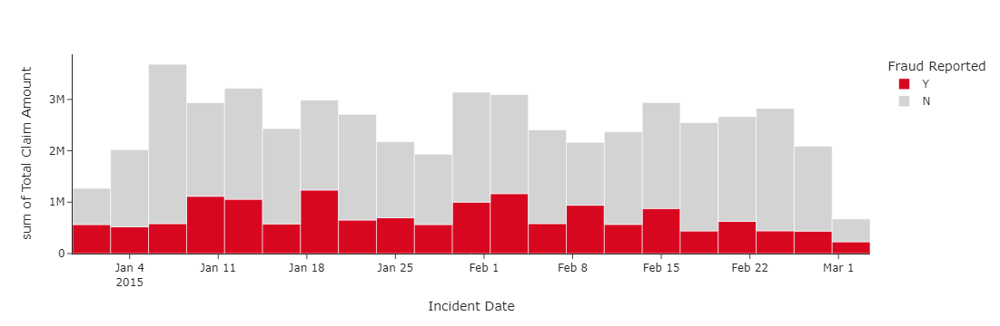

In [34]:
color_map = {
        "Y": "#D80720",
        "N": "lightgrey"}
fig = px.histogram(df_visua, x='incident_date', y='total_claim_amount', color='fraud_reported',color_discrete_map=color_map,
                   template="simple_white",
                  labels={"incident_date": "Incident Date", "total_claim_amount": "Total Claim Amount", "fraud_reported": "Fraud Reported"})
fig.show()

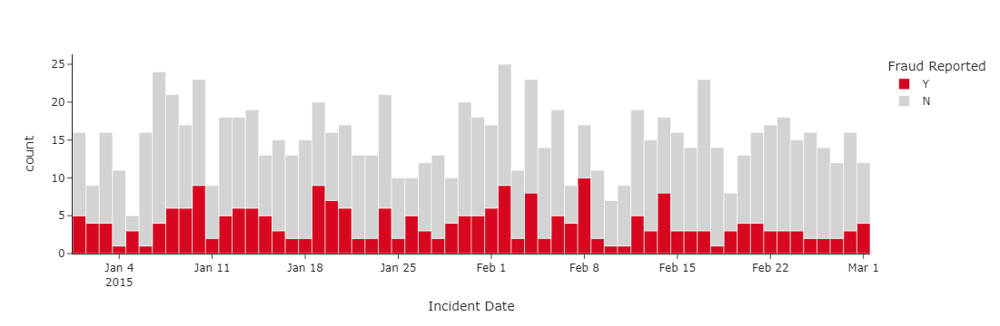

In [35]:
fig = px.histogram(df_visua, x="incident_date",nbins=100, color='fraud_reported',color_discrete_map=color_map,
                   template="simple_white",
                  labels={"incident_date": "Incident Date", "fraud_reported": "Fraud Reported"})
fig.show()

The image below illustrates the distribution of claimed amounts by city and gender in those who are reported as fraudulent. It's evident that in all cities, one gender has a higher representation.

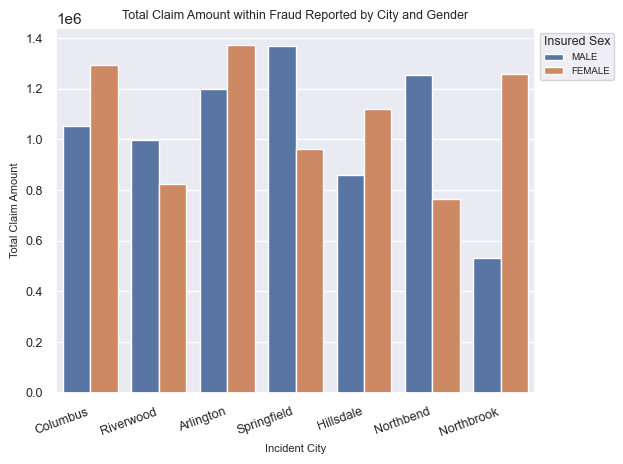

In [36]:
df_fraud_reported = df_visua[df_visua['fraud_reported'] == 'Y']
sns.barplot(data=df_fraud_reported, x="incident_city", y="total_claim_amount", estimator=sum, hue='insured_sex', errorbar=None)

legend = plt.legend(title='Insured Sex', bbox_to_anchor=(1, 1), fontsize=7)
plt.setp(legend.get_title(), fontsize='9')
plt.xlabel('Incident City', fontsize=8)
plt.ylabel('Total Claim Amount', fontsize=8)
plt.title('Total Claim Amount within Fraud Reported by City and Gender', fontsize=9)
plt.xticks(rotation=20, ha='right')
plt.tick_params(axis='both', which='major', labelsize=9)
plt.tight_layout()
plt.show()

However, as we've learned, correlation doesn’t necessarily imply causation. An image is displayed to investigate whether the higher frequency of fraudulent claims in certain genders is due to their prevalence. For example, in Riverwood, there are more males reported for fraudulence, while the total number of claims shows more females. This suggests a higher risk for males to make fraudulent claims in this city.

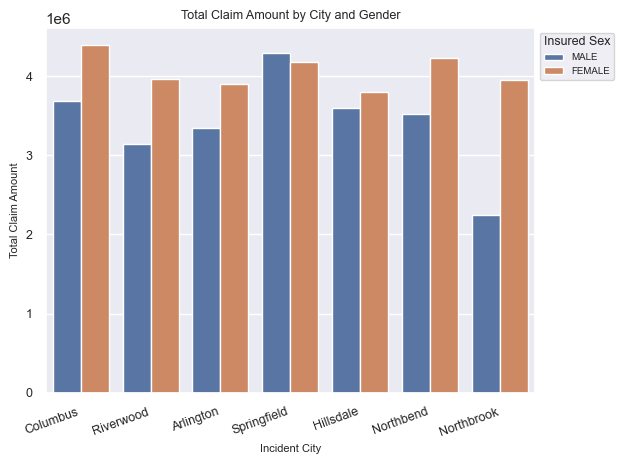

In [37]:
sns.barplot(df_visua, x="incident_city", y="total_claim_amount", estimator="sum", hue= 'insured_sex', errorbar=None)

legend = plt.legend(title='Insured Sex', bbox_to_anchor=(1, 1), fontsize=7)
plt.setp(legend.get_title(), fontsize='9')
plt.xlabel('Incident City', fontsize=8)
plt.ylabel('Total Claim Amount', fontsize=8)
plt.title('Total Claim Amount by City and Gender', fontsize=9)
plt.xticks(rotation=20, ha='right')
plt.tick_params(axis='both', which='major', labelsize=9)
plt.tight_layout()
plt.show()

Percentage of Claims Reported as fraudulent by City and Gender

In [38]:
# Filter the DataFrame for reported fraud cases
df_fraud_reported = df_visua[df_visua['fraud_reported'] == 'Y']

# Calculate the total claim amount for each incident city and insured sex
total_claim_by_city_sex = df_fraud_reported.groupby(['incident_city', 'insured_sex'])['total_claim_amount'].sum().reset_index()

# Calculate the percentage of each insured sex within each incident city
total_claim_by_city = total_claim_by_city_sex.groupby('incident_city')['total_claim_amount'].transform('sum')
total_claim_by_city_sex['percentage'] = (total_claim_by_city_sex['total_claim_amount'] / total_claim_by_city) * 100

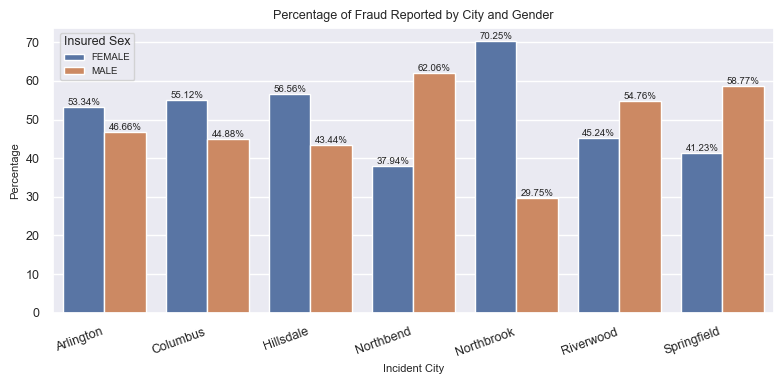

In [39]:
plt.figure(figsize=(8, 4)) 
ax = sns.barplot(data=total_claim_by_city_sex, x="incident_city", y="percentage", hue='insured_sex')

# Annotate the bars with percentage values using bar_label
for p in ax.containers:
    ax.bar_label(p, fmt='%.2f%%', label_type='edge', fontsize=7)

legend = plt.legend(title='Insured Sex', bbox_to_anchor=(0.12, 1), fontsize=7)
plt.setp(legend.get_title(), fontsize='9')
plt.xlabel('Incident City', fontsize=8)
plt.ylabel('Percentage', fontsize=8)
plt.title('Percentage of Fraud Reported by City and Gender', fontsize=9)
plt.xticks(rotation=20, ha='right')
plt.tick_params(axis='both', which='major', labelsize=9)
plt.tight_layout()
plt.show()

In [40]:
total_claim_by_city_sex

,incident_city,insured_sex,total_claim_amount,percentage
0,Arlington,FEMALE,1372440,53.344216
1,Arlington,MALE,1200360,46.655784
2,Columbus,FEMALE,1295150,55.119333
3,Columbus,MALE,1054570,44.880667
4,Hillsdale,FEMALE,1118240,56.559321
5,Hillsdale,MALE,858870,43.440679
6,Northbend,FEMALE,766640,37.937638
7,Northbend,MALE,1254150,62.062362
8,Northbrook,FEMALE,1256610,70.250734
9,Northbrook,MALE,532140,29.749266


The scatter plot below suggests a normal distribution in 'Property Claim' and 'Injury Claim', whereas 'Vehicle Claim' stands out as the costliest, with a wider range of claimed amounts.

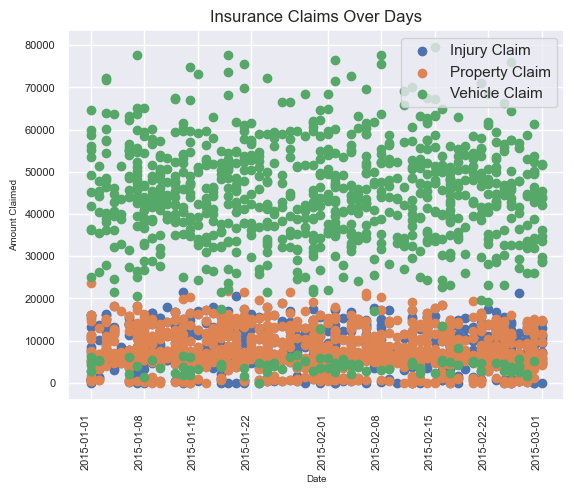

In [41]:

df_sorted_days = df_visua.sort_values(by='incident_date')
injury = df_sorted_days['injury_claim']
property = df_sorted_days['property_claim']
vehicle = df_sorted_days['vehicle_claim']
date_inc = df_sorted_days['incident_date']

plt.scatter(date_inc, injury, label='Injury Claim')
plt.scatter(date_inc, property, label='Property Claim')
plt.scatter(date_inc, vehicle, label='Vehicle Claim')

plt.xlabel('Date', fontsize=7)
plt.ylabel('Amount Claimed', fontsize=7)

plt.title('Insurance Claims Over Days')

# Add a legend
plt.legend()
plt.xticks(rotation=90, ha='right')
plt.tick_params(axis='both', labelsize=8)
plt.show()

In [42]:
df_visua.columns

Index(['months_as_customer', 'age', 'policy_state', 'policy_deductable',
       'policy_annual_premium', 'umbrella_limit', 'insured_sex',
       'insured_education_level', 'insured_occupation', 'insured_relationship',
       'capital-gains', 'capital-loss', 'incident_date', 'incident_type',
       'collision_type', 'incident_severity', 'authorities_contacted',
       'incident_city', 'incident_hour_of_the_day',
       'number_of_vehicles_involved', 'property_damage', 'bodily_injuries',
       'witnesses', 'police_report_available', 'total_claim_amount',
       'injury_claim', 'property_claim', 'vehicle_claim', 'auto_year',
       'fraud_reported', 'age_group'],
      dtype='object')

The '.describe' function showcases the statistical variables of six selected features. 
By the images below, it suggests that the mean of the “total claim amount” is around 10% higher when reported as fraudulent. Similarly occurs in injury claims, property claims and vehicle claims.

In [43]:
df_no_fraud_reported = df_visua[df_visua['fraud_reported'] == 'N']

In [44]:
df_no_fraud_reported[['months_as_customer', 'age', 'total_claim_amount', 'injury_claim','property_claim', 'vehicle_claim']].describe()

,months_as_customer,age,total_claim_amount,injury_claim,property_claim,vehicle_claim
count,668.000000,668.000000,668.000000,668.000000,668.000000,668.000000
mean,203.750000,38.979042,56001.152695,7994.505988,7814.940120,40191.706587
std,114.905223,9.063139,23821.104165,4673.094050,4544.501546,16972.485320
min,0.000000,20.000000,100.000000,0.000000,0.000000,70.000000
25%,115.750000,32.000000,45682.500000,5162.500000,5015.000000,33057.500000
50%,201.500000,38.000000,59400.000000,7105.000000,6985.000000,43000.000000
75%,277.000000,44.250000,71490.000000,11580.000000,11190.000000,51467.500000
max,479.000000,64.000000,114920.000000,21450.000000,23670.000000,79560.000000


In [45]:
df_fraud_reported[['months_as_customer', 'age', 'total_claim_amount', 'injury_claim','property_claim', 'vehicle_claim']].describe()

,months_as_customer,age,total_claim_amount,injury_claim,property_claim,vehicle_claim
count,241.000000,241.000000,241.000000,241.000000,241.000000,241.000000
mean,208.568465,39.211618,61683.319502,8395.767635,8757.759336,44529.792531
std,119.164507,9.557765,19033.322155,4446.270761,4513.650126,13600.468664
min,3.000000,19.000000,3900.000000,0.000000,0.000000,2730.000000
25%,116.000000,32.000000,52800.000000,5540.000000,5940.000000,37680.000000
50%,203.000000,38.000000,62880.000000,7340.000000,7510.000000,45180.000000
75%,279.000000,45.000000,73260.000000,11940.000000,11600.000000,52080.000000
max,473.000000,62.000000,112320.000000,20700.000000,21810.000000,77760.000000


When ‘object’ is included in the code, it shows that in fraudulent claims the most common “incident_severy” is Major Damage, while in not fraudulent claims is Minor Damage.

In [46]:
df_fraud_reported.describe(include=object)

,policy_state,insured_sex,insured_education_level,insured_occupation,insured_relationship,incident_type,collision_type,incident_severity,authorities_contacted,incident_city,property_damage,police_report_available,fraud_reported
count,241,241,241,241,241,241,231,241,241,241,140,154,241
unique,3,2,7,14,6,4,3,4,4,7,2,2,1
top,OH,FEMALE,JD,exec-managerial,other-relative,Single Vehicle Collision,Rear Collision,Major Damage,Other,Arlington,YES,NO,Y
freq,89,122,40,27,51,117,91,167,63,41,75,84,241


In [47]:
df_no_fraud_reported.describe(include=object)

,policy_state,insured_sex,insured_education_level,insured_occupation,insured_relationship,incident_type,collision_type,incident_severity,authorities_contacted,incident_city,property_damage,police_report_available,fraud_reported
count,668,668,668,668,668,668,591,668,668,668,440,439,668
unique,3,2,7,14,6,4,3,4,4,7,2,2,1
top,IL,FEMALE,High School,machine-op-inspct,own-child,Multi-vehicle Collision,Side Collision,Minor Damage,Police,Springfield,NO,NO,N
freq,235,372,112,66,127,305,206,270,231,107,239,223,668


In [48]:
df_visua.describe(include=object)

,policy_state,insured_sex,insured_education_level,insured_occupation,insured_relationship,incident_type,collision_type,incident_severity,authorities_contacted,incident_city,property_damage,police_report_available,fraud_reported
count,909,909,909,909,909,909,822,909,909,909,580,593,909
unique,3,2,7,14,6,4,3,4,4,7,2,2,2
top,OH,FEMALE,High School,machine-op-inspct,own-child,Multi-vehicle Collision,Rear Collision,Minor Damage,Police,Springfield,NO,NO,N
freq,319,494,146,87,165,419,292,304,292,145,304,307,668


In [49]:
df_fraud_reported.columns

Index(['months_as_customer', 'age', 'policy_state', 'policy_deductable',
       'policy_annual_premium', 'umbrella_limit', 'insured_sex',
       'insured_education_level', 'insured_occupation', 'insured_relationship',
       'capital-gains', 'capital-loss', 'incident_date', 'incident_type',
       'collision_type', 'incident_severity', 'authorities_contacted',
       'incident_city', 'incident_hour_of_the_day',
       'number_of_vehicles_involved', 'property_damage', 'bodily_injuries',
       'witnesses', 'police_report_available', 'total_claim_amount',
       'injury_claim', 'property_claim', 'vehicle_claim', 'auto_year',
       'fraud_reported', 'age_group'],
      dtype='object')

Since "incident_severity" appears to be correlated with fraud detection, histograms are displayed to thoroughly examine five features.

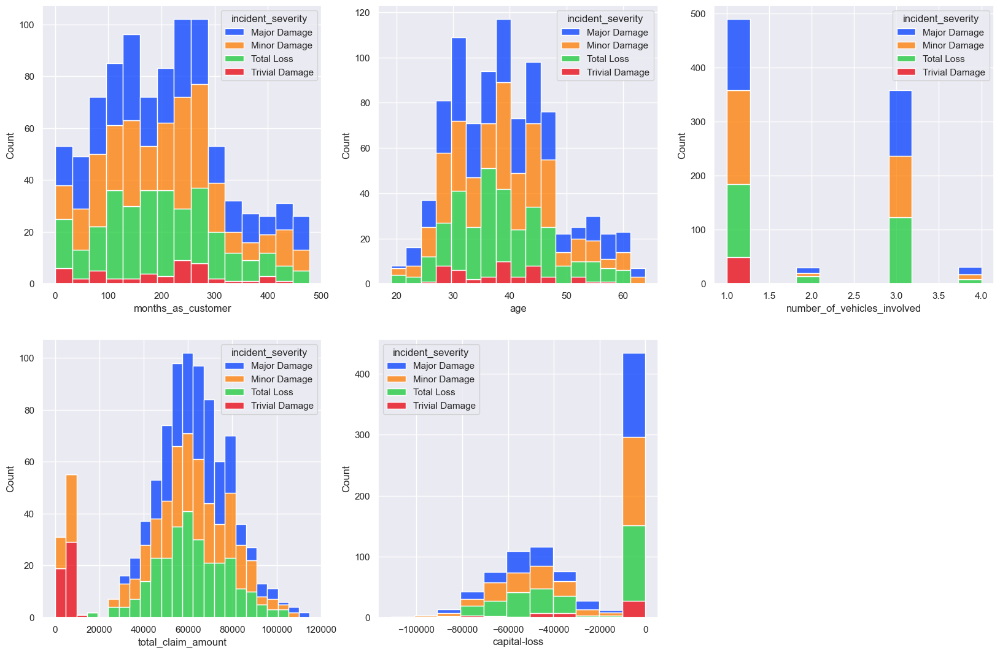

In [50]:
histogram_fraudulent = ['months_as_customer', 'age','number_of_vehicles_involved','total_claim_amount','capital-loss']
plt.figure(figsize=[20,20])
for z in enumerate(histogram_fraudulent):
    plt.subplot(3,3,z[0]+1)
    sns.histplot(df,x =z[1],hue='incident_severity',palette='bright', multiple="stack")

## Outliers
Identifying outliers is an important step as some machine learning models are sensitive to them.Four features, 'months_as_customer', 'age', 'number_of_vehicles_involved' and 'total_claim_amount' are displayed to check its distribution:

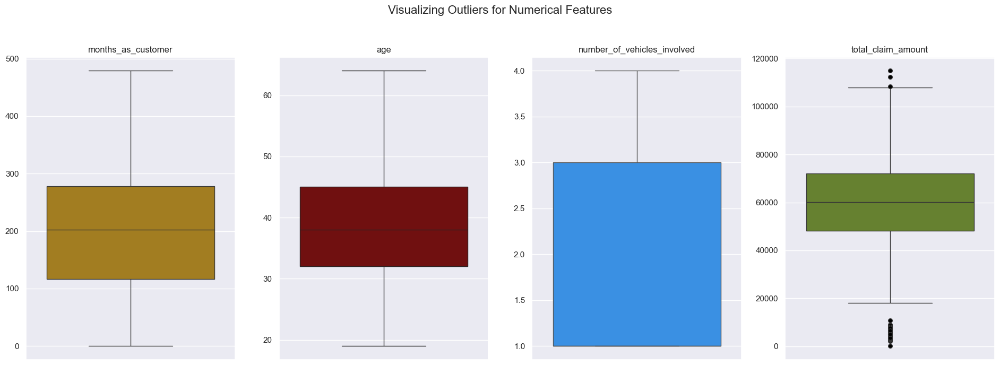

In [51]:
fig, axs = plt.subplots(1,4,figsize=(19,7))
clmns = ['months_as_customer', 'age','number_of_vehicles_involved','total_claim_amount']
colors = ['darkgoldenrod','maroon','dodgerblue','olivedrab']

for i,(column,color) in enumerate(zip(clmns,colors)):
    sns.boxplot(y = column ,data = df_visua,ax = axs[i] ,color=color,flierprops=dict(markerfacecolor='black', marker='.', markersize=11))
    axs[i].set_title(column)
    axs[i].set(ylabel = None)

plt.suptitle('Visualizing Outliers for Numerical Features', fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()
     

In [52]:
# Counting outliers
def count_outliers(column):
    Q1 = column.quantile(0.25)
    Q3 = column.quantile(0.75)
    IQR = Q3 - Q1
    lower_limit = Q1 - 1.5 * IQR
    upper_limit = Q3 + 1.5 * IQR
    print(f'Number of records with outliers in {column.name} :', df_visua[(column < lower_limit) | (column > upper_limit)].shape[0])
count_outliers(df_visua['months_as_customer'])
count_outliers(df_visua['age'])
count_outliers(df_visua['number_of_vehicles_involved'])
count_outliers(df_visua['total_claim_amount'])

Number of records with outliers in months_as_customer : 0
Number of records with outliers in age : 0
Number of records with outliers in number_of_vehicles_involved : 0
Number of records with outliers in total_claim_amount : 90


There are 90 rows identified as outliers in the 'total_claim_amount', which is considered normal due to the fewer claims with extreme amounts. Since altering them wouldn't result in any significant improvement to the model, I've opted to retain them.

## Encoding categorical features
Categorical features with up to three unique variables are encoded using LabelEncoder:

In [53]:
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()

# columns to encode
columns_categ = ["insured_sex", "collision_type", "property_damage", "police_report_available", "fraud_reported"]

# Encode categorical values within each column
for col in columns_categ:
    df[col] = label_encoder.fit_transform(df[col])

In [54]:
df.head()

,months_as_customer,age,policy_state,policy_deductable,policy_annual_premium,umbrella_limit,insured_sex,insured_education_level,insured_occupation,insured_relationship,...,property_damage,bodily_injuries,witnesses,police_report_available,total_claim_amount,injury_claim,property_claim,vehicle_claim,auto_year,fraud_reported
0,328,48,OH,1000,1406.91,0,1,MD,craft-repair,husband,...,1,1,2,1,71610,6510,13020,52080,2004,1
1,228,42,IN,2000,1197.22,5000000,1,MD,machine-op-inspct,other-relative,...,2,0,0,2,5070,780,780,3510,2007,1
2,134,29,OH,2000,1413.14,5000000,0,PhD,sales,own-child,...,0,2,3,0,34650,7700,3850,23100,2007,0
3,256,41,IL,2000,1415.74,6000000,0,PhD,armed-forces,unmarried,...,2,1,2,0,63400,6340,6340,50720,2014,1
5,256,39,OH,1000,1351.10,0,0,PhD,tech-support,unmarried,...,0,0,2,0,64100,6410,6410,51280,2003,1


Dictionary: 
insured_sex: 1 Male, 0 Female
collision_type: 0-Front Collision, 1-Rear Collision, 2-Side Collision, 3-Unknown 
property_damage: 1-Yes 2-Unknow 0-No
police_report_available: 1-Yes 2-Unknow 0-No
fraud_reported: 1-Yes 0-No

In [55]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 909 entries, 0 to 999
Data columns (total 30 columns):
 #   Column                       Non-Null Count  Dtype         
---  ------                       --------------  -----         
 0   months_as_customer           909 non-null    int64         
 1   age                          909 non-null    int64         
 2   policy_state                 909 non-null    object        
 3   policy_deductable            909 non-null    int64         
 4   policy_annual_premium        909 non-null    float64       
 5   umbrella_limit               909 non-null    int64         
 6   insured_sex                  909 non-null    int32         
 7   insured_education_level      909 non-null    object        
 8   insured_occupation           909 non-null    object        
 9   insured_relationship         909 non-null    object        
 10  capital-gains                909 non-null    int64         
 11  capital-loss                 909 non-null    int64

In [56]:
df_categ = df[['insured_occupation', 'incident_severity', 'incident_city']]
df_categ.head()

,insured_occupation,incident_severity,incident_city
0,craft-repair,Major Damage,Columbus
1,machine-op-inspct,Minor Damage,Riverwood
2,sales,Minor Damage,Columbus
3,armed-forces,Major Damage,Arlington
5,tech-support,Major Damage,Arlington


A separate data frame is created containing only numerical features

In [57]:
df_num = df.drop(columns=["insured_education_level", 'insured_occupation', 'insured_relationship', 
                          'incident_type', 'authorities_contacted', 'incident_severity', 'policy_state', 'incident_city'])

In [58]:
df_num.head()

,months_as_customer,age,policy_deductable,policy_annual_premium,umbrella_limit,insured_sex,capital-gains,capital-loss,incident_date,collision_type,...,property_damage,bodily_injuries,witnesses,police_report_available,total_claim_amount,injury_claim,property_claim,vehicle_claim,auto_year,fraud_reported
0,328,48,1000,1406.91,0,1,53300,0,2015-01-25,2,...,1,1,2,1,71610,6510,13020,52080,2004,1
1,228,42,2000,1197.22,5000000,1,0,0,2015-01-21,3,...,2,0,0,2,5070,780,780,3510,2007,1
2,134,29,2000,1413.14,5000000,0,35100,0,2015-02-22,1,...,0,2,3,0,34650,7700,3850,23100,2007,0
3,256,41,2000,1415.74,6000000,0,48900,-62400,2015-01-10,0,...,2,1,2,0,63400,6340,6340,50720,2014,1
5,256,39,1000,1351.10,0,0,0,0,2015-01-02,1,...,0,0,2,0,64100,6410,6410,51280,2003,1


## Correlation

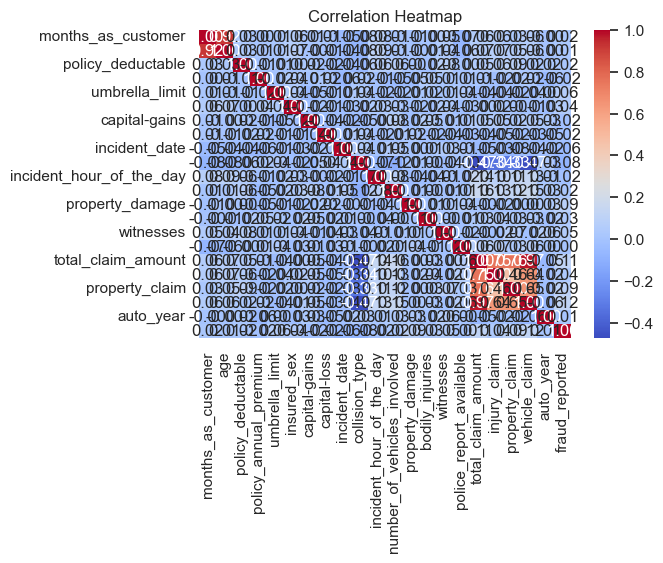

In [59]:
correlation_matrix = df_num.corr()

# Plotting the heatmap
plt.figure(figsize=(6, 4))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Correlation Heatmap")
plt.show()

In addition, a heatmap is displayed to show the correlation of the columns with the feature “fraud_reported”, where those with low correlation will be dropped. 

<Axes: >

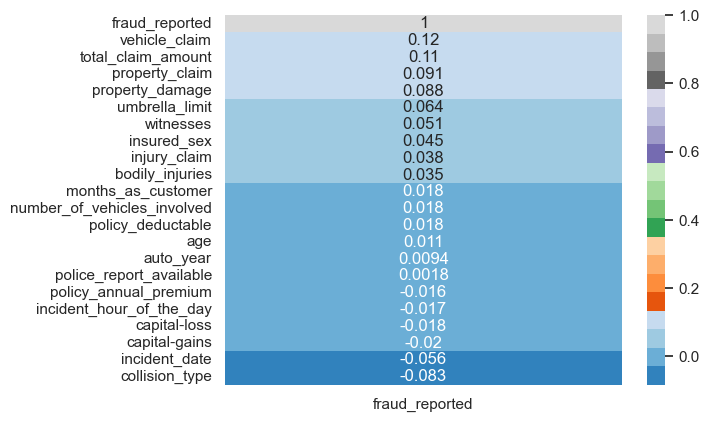

In [60]:
sns.heatmap(df_num.corr()[['fraud_reported']].nlargest(40,'fraud_reported'),annot=True,cmap='tab20c')

In [61]:
df_num = df_num.drop(columns=["collision_type", "capital-gains", "capital-loss", "policy_annual_premium", "incident_hour_of_the_day",
                          "auto_year", "police_report_available", 'incident_date'])

In [62]:
df_num.columns.unique()

Index(['months_as_customer', 'age', 'policy_deductable', 'umbrella_limit',
       'insured_sex', 'number_of_vehicles_involved', 'property_damage',
       'bodily_injuries', 'witnesses', 'total_claim_amount', 'injury_claim',
       'property_claim', 'vehicle_claim', 'fraud_reported'],
      dtype='object')

In [63]:
histplot_columns = ['policy_deductable','policy_annual_premium', 'umbrella_limit',
                    'capital-gains','capital-loss','months_as_customer','age','total_claim_amount']

In [64]:
list(enumerate(histplot_columns))

[(0, 'policy_deductable'),
 (1, 'policy_annual_premium'),
 (2, 'umbrella_limit'),
 (3, 'capital-gains'),
 (4, 'capital-loss'),
 (5, 'months_as_customer'),
 (6, 'age'),
 (7, 'total_claim_amount')]

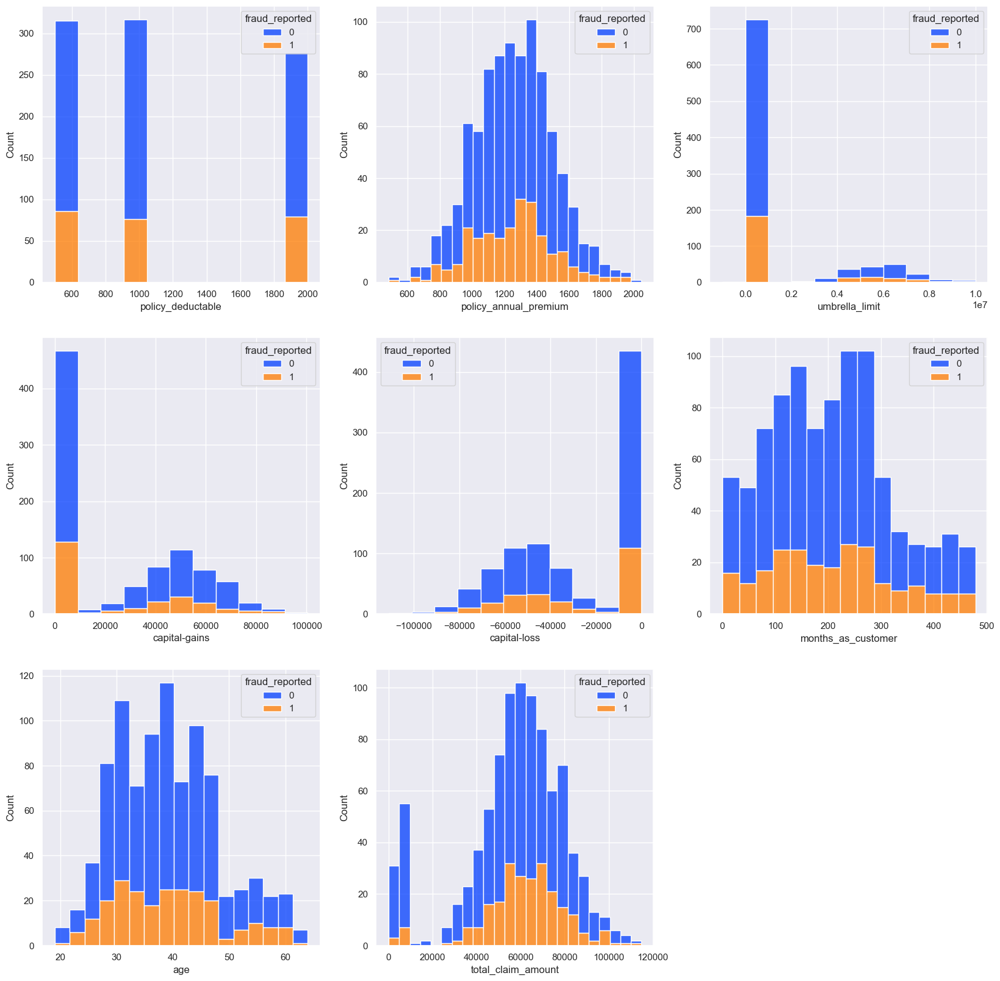

In [65]:
plt.figure(figsize=[20,20])
for z in enumerate(histplot_columns):
    plt.subplot(3,3,z[0]+1)
    sns.histplot(df,x =z[1],hue='fraud_reported',palette='bright', multiple="stack")

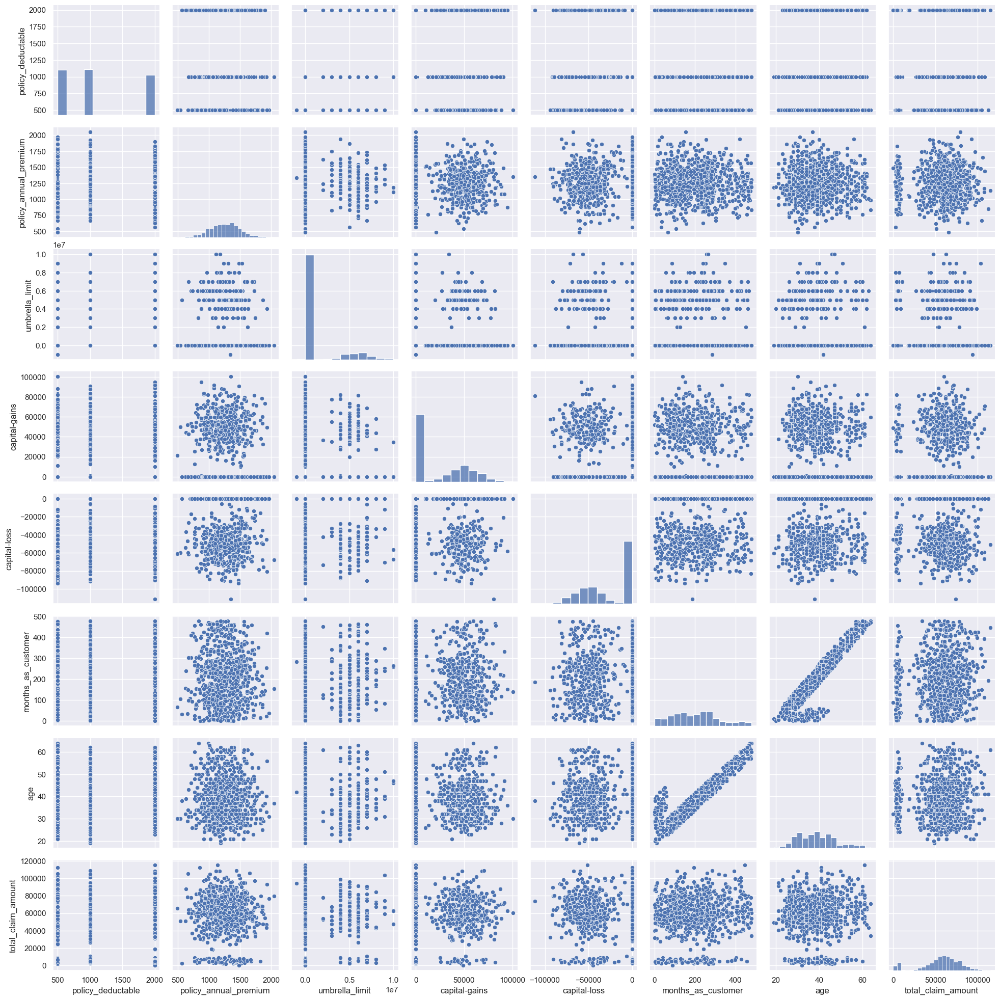

In [66]:
sns.pairplot(df[histplot_columns])

In [67]:
df_categ.head()

,insured_occupation,incident_severity,incident_city
0,craft-repair,Major Damage,Columbus
1,machine-op-inspct,Minor Damage,Riverwood
2,sales,Minor Damage,Columbus
3,armed-forces,Major Damage,Arlington
5,tech-support,Major Damage,Arlington


Categorical features that have more than three unique variables are encoded employing OneHotEncoder. It transforms each categorical feature into a new set of binary features (0s and 1s). Each binary feature corresponds to one of the unique categories in the original feature. OneHotEncoder is useful because many machine learning algorithms require numerical input, and encoding categorical features into a numerical format allows these algorithms to effectively learn from categorical data.

In [68]:
from sklearn.preprocessing import OneHotEncoder
encoder = OneHotEncoder()
cat_encoder=pd.DataFrame(encoder.fit_transform(df_categ).toarray())

In [69]:
# Perform one-hot encoding
df_categ = pd.get_dummies(df_categ, drop_first=True)
df_categ = df_categ.astype(int)
df_categ.head()

,insured_occupation_armed-forces,insured_occupation_craft-repair,insured_occupation_exec-managerial,insured_occupation_farming-fishing,insured_occupation_handlers-cleaners,insured_occupation_machine-op-inspct,insured_occupation_other-service,insured_occupation_priv-house-serv,insured_occupation_prof-specialty,insured_occupation_protective-serv,...,insured_occupation_transport-moving,incident_severity_Minor Damage,incident_severity_Total Loss,incident_severity_Trivial Damage,incident_city_Columbus,incident_city_Hillsdale,incident_city_Northbend,incident_city_Northbrook,incident_city_Riverwood,incident_city_Springfield
0,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
1,0,0,0,0,0,1,0,0,0,0,...,0,1,0,0,0,0,0,0,1,0
2,0,0,0,0,0,0,0,0,0,0,...,0,1,0,0,1,0,0,0,0,0
3,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [70]:
df_fraud = df_num.join(df_categ)
df_fraud.head()

,months_as_customer,age,policy_deductable,umbrella_limit,insured_sex,number_of_vehicles_involved,property_damage,bodily_injuries,witnesses,total_claim_amount,...,insured_occupation_transport-moving,incident_severity_Minor Damage,incident_severity_Total Loss,incident_severity_Trivial Damage,incident_city_Columbus,incident_city_Hillsdale,incident_city_Northbend,incident_city_Northbrook,incident_city_Riverwood,incident_city_Springfield
0,328,48,1000,0,1,1,1,1,2,71610,...,0,0,0,0,1,0,0,0,0,0
1,228,42,2000,5000000,1,1,2,0,0,5070,...,0,1,0,0,0,0,0,0,1,0
2,134,29,2000,5000000,0,3,0,2,3,34650,...,0,1,0,0,1,0,0,0,0,0
3,256,41,2000,6000000,0,1,2,1,2,63400,...,0,0,0,0,0,0,0,0,0,0
5,256,39,1000,0,0,3,0,0,2,64100,...,0,0,0,0,0,0,0,0,0,0


In [71]:
df_fraud.isnull().sum()

months_as_customer                      0
age                                     0
policy_deductable                       0
umbrella_limit                          0
insured_sex                             0
number_of_vehicles_involved             0
property_damage                         0
bodily_injuries                         0
witnesses                               0
total_claim_amount                      0
injury_claim                            0
property_claim                          0
vehicle_claim                           0
fraud_reported                          0
insured_occupation_armed-forces         0
insured_occupation_craft-repair         0
insured_occupation_exec-managerial      0
insured_occupation_farming-fishing      0
insured_occupation_handlers-cleaners    0
insured_occupation_machine-op-inspct    0
insured_occupation_other-service        0
insured_occupation_priv-house-serv      0
insured_occupation_prof-specialty       0
insured_occupation_protective-serv

In [72]:
df_fraud.columns.unique()

Index(['months_as_customer', 'age', 'policy_deductable', 'umbrella_limit',
       'insured_sex', 'number_of_vehicles_involved', 'property_damage',
       'bodily_injuries', 'witnesses', 'total_claim_amount', 'injury_claim',
       'property_claim', 'vehicle_claim', 'fraud_reported',
       'insured_occupation_armed-forces', 'insured_occupation_craft-repair',
       'insured_occupation_exec-managerial',
       'insured_occupation_farming-fishing',
       'insured_occupation_handlers-cleaners',
       'insured_occupation_machine-op-inspct',
       'insured_occupation_other-service',
       'insured_occupation_priv-house-serv',
       'insured_occupation_prof-specialty',
       'insured_occupation_protective-serv', 'insured_occupation_sales',
       'insured_occupation_tech-support',
       'insured_occupation_transport-moving', 'incident_severity_Minor Damage',
       'incident_severity_Total Loss', 'incident_severity_Trivial Damage',
       'incident_city_Columbus', 'incident_city_Hills

So far the pre-processed dataset has 909 rows and 36 columns:

In [73]:
df_fraud.shape

(909, 36)

In [74]:
#pip install chart-studio

The feature “fraud_reported” will be used as a target in order to make predictions about whether a claim is identified as fraudulent or not. Displaying a pie chart we can see that the class is highly imbalanced with 73% of non-fraudulent and 27% being reported as fraudulent. This is an issue that will be handled later. 

<Axes: ylabel='count'>

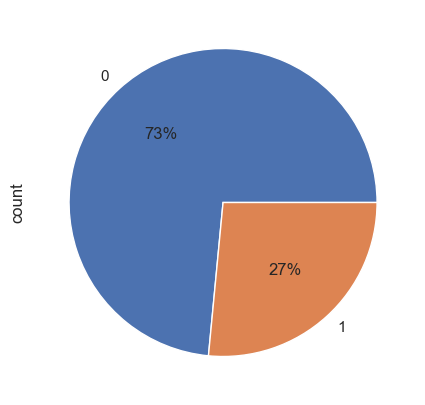

In [75]:
plt.figure(figsize=(8,5))
df_fraud['fraud_reported'].value_counts().plot(kind="pie",autopct='%1.0f%%')

array([[<Axes: title={'center': 'fraud_reported'}>]], dtype=object)

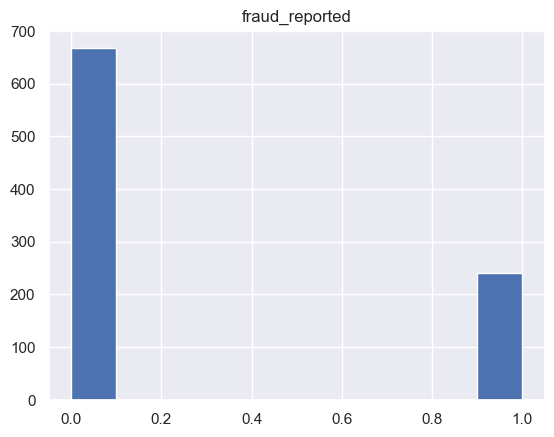

In [76]:
df_fraud.hist(column="fraud_reported")

## Deciding Model 
With a pre-processed dataset in hand, I'll test seven models and choose the top three based on their metrics for further analysis and improvement. These models are selected for their interpretability and efficiency, ensuring they are easy to interpret and not overly time-consuming. 
Libraries used:


In [78]:
from matplotlib import pyplot
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import StratifiedKFold
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.svm import SVC

The target variable 'y' is set to "fraud_reported", while the remaining columns are assigned to 'X'. The dataset is split into training and testing sets to ensure the model's efficiency. Given the imbalanced class, the 'stratify' parameter is set to 'y', ensuring that class distribution is maintained in both the training and testing sets. The test set serves as a sample of the data reserved for final model evaluation, providing confidence in its accuracy on unseen data. I've allocated 80% of the data for model training and reserved 20% for testing purposes.

In [79]:
X = df_fraud.drop('fraud_reported', axis=1)  # Independent variables
y = df_fraud['fraud_reported']  # Dependent variable

X_train, X_test, y_train, y_test = train_test_split(X, y, random_state = 1, stratify=y)

In [80]:
models = []
models.append(('LR', LogisticRegression(solver='newton-cg', multi_class='ovr')))
models.append(('LDA', LinearDiscriminantAnalysis()))
models.append(('KNN', KNeighborsClassifier()))
models.append(('CART', DecisionTreeClassifier()))
models.append(('NB', GaussianNB()))
models.append(('SVM', SVC(gamma='auto')))
models.append(('RF', RandomForestClassifier()))

Initially, when analyzing only accuracy, the metrics might seem satisfactory. However, upon examining the confusion matrix, particularly in cases where fraudulence is reported, we observe poor performance

In [81]:
results = []
names = []
for name, model in models:
	kfold = StratifiedKFold(n_splits=10, random_state=1, shuffle=True)
	cv_results = cross_val_score(model, X_train, y_train, cv=kfold, scoring='accuracy')
	results.append(cv_results)
	names.append(name)
	print('%s: %f (%f)' % (name, cv_results.mean(), cv_results.std()))

LR: 0.751876 (0.019627)
LDA: 0.803346 (0.044456)
KNN: 0.685742 (0.024925)
CART: 0.721121 (0.063724)
NB: 0.704902 (0.016810)
SVM: 0.734228 (0.003197)
RF: 0.754838 (0.040611)


In [82]:
results = []
names = []
conf_matrices = []

for name, model in models:
    # Train the model on the entire training set
    model.fit(X_train, y_train)
    
    # Make predictions on the test set
    y_pred = model.predict(X_test)
    
    # Compute the confusion matrix
    cm = confusion_matrix(y_test, y_pred)
    conf_matrices.append(cm)
    
    # Print the confusion matrix
    print(f"Confusion matrix for {name}:")
    print(cm)

Confusion matrix for LR:
[[156  12]
 [ 46  14]]
Confusion matrix for LDA:
[[137  31]
 [ 24  36]]
Confusion matrix for KNN:
[[152  16]
 [ 55   5]]
Confusion matrix for CART:
[[142  26]
 [ 39  21]]
Confusion matrix for NB:
[[166   2]
 [ 53   7]]
Confusion matrix for SVM:
[[168   0]
 [ 60   0]]
Confusion matrix for RF:
[[156  12]
 [ 43  17]]


In scenarios where the priority is to minimize false negatives while accepting the possibility of false positives, we opt for decision thresholds characterized by either low Precision or high Recall values. For instance, in fraud detection systems, the primary concern is to ensure that no fraudulent activity goes undetected, even if it means tolerating some instances of misclassifying legitimate transactions as fraudulent. This approach is justified by the fact that the absence of fraud can be confirmed through additional investigations, whereas failing to identify fraudulent activity can have significant consequences.
Chosen Recall as the main metric, it is notable how it decreased when compared with Accuracy:

In [83]:
results = []
names = []
for name, model in models:
	kfold = StratifiedKFold(n_splits=10, random_state=1, shuffle=True)
	cv_results = cross_val_score(model, X_train, y_train, cv=kfold, scoring='recall')
	results.append(cv_results)
	names.append(name)
	print('%s: %f (%f)' % (name, cv_results.mean(), cv_results.std()))

LR: 0.219883 (0.130042)
LDA: 0.679532 (0.088825)
KNN: 0.093860 (0.025134)
CART: 0.459649 (0.116401)
NB: 0.038889 (0.043390)
SVM: 0.000000 (0.000000)
RF: 0.292690 (0.054850)


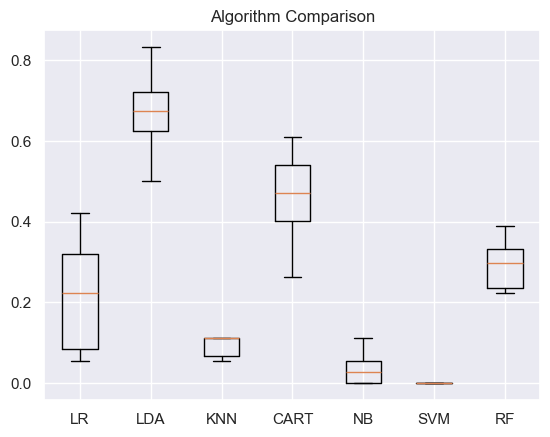

In [84]:
pyplot.boxplot(results, labels=names)
pyplot.title('Algorithm Comparison')
pyplot.show()

The models are employed using Stratified K-Fold Cross Validation. Predictive model building prompts the question: How accurate are the predictions? Quantifying expected model performance is vital in machine learning projects. Cross-validation methods assess prediction effectiveness by dividing data into training and test sets. The model is trained on one set and tested on another, allowing estimation of performance on unseen data. Stratified K-Fold Cross Validation is similar to K-Fold Cross Validation, but with an additional step to ensure that each fold has approximately the same proportion of target classes as the whole dataset. This is particularly useful when dealing with imbalanced datasets, which is the case of this dataset. 

# SMOTE
Given its unbalanced distribution, the SMOTE technique is employed to mitigate it. Addressing imbalance in datasets is crucial in machine learning to ensure more reliable results. Without addressing the imbalance, models may overfit by memorizing and predicting all instances as non-fraudulent.
SMOTE (Synthetic Minority Over-sampling Technique) is a method employed to balance the distribution of classes within a dataset by oversampling or undersampling, resulting in a more evenly distributed dataset..


In [85]:
from collections import Counter
from imblearn.over_sampling import SMOTE

In [86]:
X = df_fraud.drop('fraud_reported', axis=1)  # Independent variables
y_imbalanced = df_fraud['fraud_reported']  # Dependent variable

In [87]:
from sklearn.datasets import make_classification

def create_dataset(
    n_samples=909,
    weights=(0.27, 0.73),
    n_classes=2,
    class_sep=0.8,
    n_clusters=1,
):
    return make_classification(
        n_samples=n_samples,
        n_features=2,
        n_informative=2,
        n_redundant=0,
        n_repeated=0,
        n_classes=n_classes,
        n_clusters_per_class=n_clusters,
        weights=list(weights),
        class_sep=class_sep,
        random_state=0,
    )

In [88]:
def plot_resampling(X, y_imbalanced, sampler, ax, title=None):
    X_res, y_res = sampler.fit_resample(X, y_imbalanced)
    ax.scatter(X_res[:, 0], X_res[:, 1], c=y_res, alpha=0.8, edgecolor="k")
    if title is None:
        title = f"Resampling with {sampler.__class__.__name__}"
    ax.set_title(title)
    sns.despine(ax=ax, offset=10)

In [89]:
def plot_decision_function(X, y_imbalanced, clf, ax, title=None):
    plot_step = 0.02
    x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
    y_min, y_max = X[:, 1].min() - 1, X[:, 1].max() + 1
    xx, yy = np.meshgrid(
        np.arange(x_min, x_max, plot_step), np.arange(y_min, y_max, plot_step)
    )

    Z = clf.predict(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)
    ax.contourf(xx, yy, Z, alpha=0.4)
    ax.scatter(X[:, 0], X[:, 1], alpha=0.8, c=y_imbalanced, edgecolor="k")
    if title is not None:
        ax.set_title(title)

In [90]:
from sklearn.linear_model import LogisticRegression
clf = LogisticRegression()

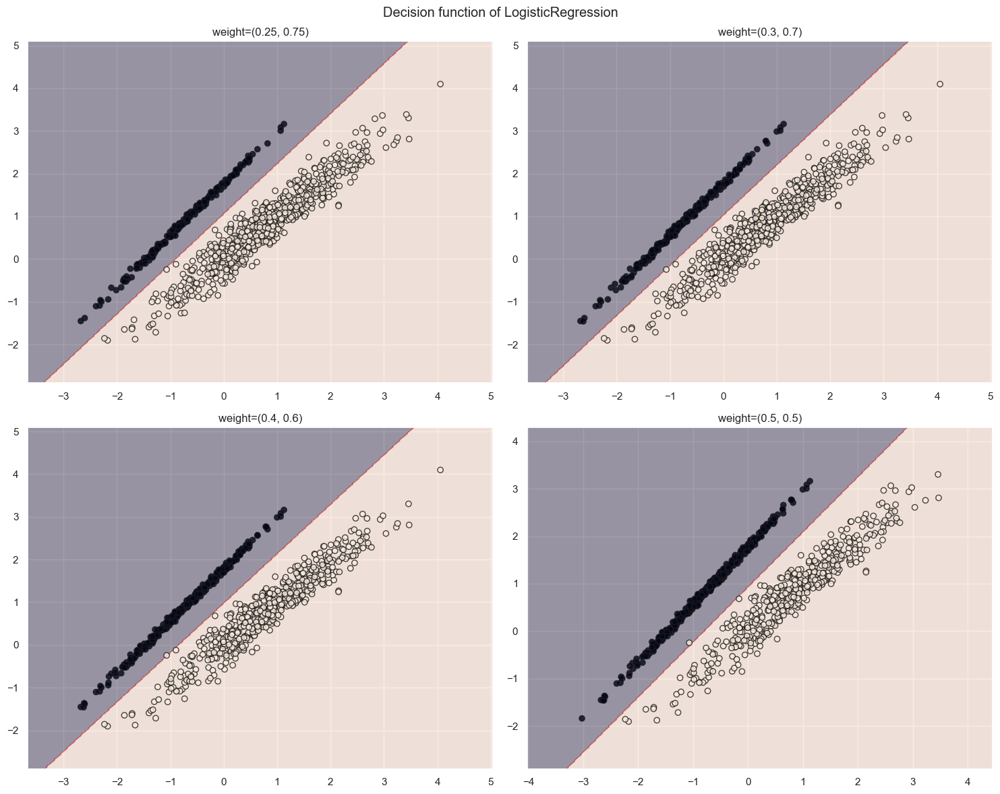

In [91]:
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(15, 12))

weights_arr = (
    (0.25, 0.75),
    (0.3, 0.7),
    (0.4, 0.6),
    (0.5, 0.5),
)
for ax, weights in zip(axs.ravel(), weights_arr):
    X, y_imbalanced = create_dataset(n_samples=900, weights=weights)
    clf.fit(X, y_imbalanced)
    plot_decision_function(X, y_imbalanced, clf, ax, title=f"weight={weights}")
    fig.suptitle(f"Decision function of {clf.__class__.__name__}")
fig.tight_layout()

In [92]:
X

array([[-1.71420228, -1.6039525 ],
       [-1.71851862, -1.63701796],
       [ 0.19241112,  0.11969003],
       ...,
       [ 0.83243279,  0.7198643 ],
       [-1.06057653,  0.53964988],
       [ 1.04040461,  1.06075714]])

In [93]:
X = df_fraud.drop('fraud_reported', axis=1)  # Independent variables
y_imbalanced = df_fraud['fraud_reported']  # Dependent variable

In [94]:
X.shape

(909, 35)

In [95]:
y_imbalanced.value_counts()

fraud_reported
0    668
1    241
Name: count, dtype: int64

In this project, sampling strategy 0.7 was used.

In [96]:
print('Original dataset shape %s' % Counter(y_imbalanced))
sm = SMOTE(random_state=42, sampling_strategy=.7)
X_res, y_res = sm.fit_resample(X, y_imbalanced)
print('Resampled dataset shape %s' % Counter(y_res))

Original dataset shape Counter({0: 668, 1: 241})
Resampled dataset shape Counter({0: 668, 1: 467})


In [97]:
X_res.shape

(1135, 35)

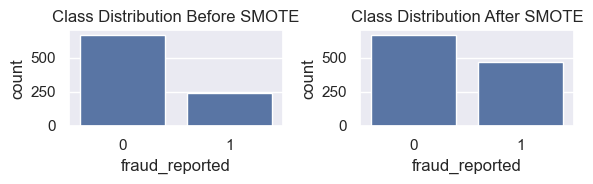

In [98]:
# Plot class distribution before SMOTE
plt.figure(figsize=(6, 2))
plt.subplot(1, 2, 1)
sns.countplot(x=y_imbalanced)
plt.title('Class Distribution Before SMOTE')

# Plot class distribution after SMOTE
plt.subplot(1, 2, 2)
sns.countplot(x=y_res)
plt.title('Class Distribution After SMOTE')

plt.tight_layout()
plt.show()

# PCA
Given that the actual dataset contains 53 columns, I'll explore whether reducing its dimensionality would lead to more reasonable metrics. The dataset used is without SMOTE.
Principal component analysis, or PCA, is a statistical procedure that allows you to summarize the information content in large data tables utilizing a smaller set of “summary indices” that can be more easily visualised and analyzed (Sartorius, 2020).


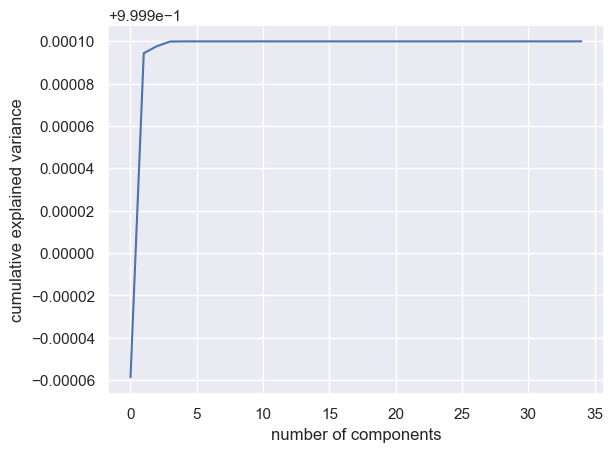

In [99]:
from sklearn.decomposition import PCA
df_no_label = df_fraud.drop('fraud_reported', axis=1)
pca = PCA().fit(df_no_label) 
plt.plot(np.cumsum(pca.explained_variance_ratio_)) 
plt.xlabel('number of components') 
plt.ylabel('cumulative explained variance'); 

In [100]:
pca = PCA(4)
projected = pca.fit_transform(df_no_label)

In [101]:
projected.shape

(909, 4)

In [102]:
df_pca = pd.DataFrame(projected, columns =['C1', 'C2', 'C3', 'C4'])

In [103]:
df_pca.shape

(909, 4)

In [104]:
df_pca.head()

,C1,C2,C3,C4
0,-1.088017e+06,-17332.920477,1203.053108,-4608.280874
1,3.912022e+06,63576.134506,-1079.317287,61.838415
2,3.912005e+06,27428.799471,-2665.176046,2689.958020
3,4.911986e+06,-12038.753366,5851.110039,494.756095
4,-1.088014e+06,-10029.631272,6042.069761,288.248954


In [105]:
X_pca = df_pca  # Independent variables
y_pca = df['fraud_reported']  # Dependent variable

In [106]:
X_train, X_test, y_train, y_test = train_test_split(X_pca, y_pca, random_state = 1, stratify=y_pca)

In [107]:
models = []
models.append(('LR', LogisticRegression(solver='liblinear', multi_class='ovr')))
models.append(('LDA', LinearDiscriminantAnalysis()))
models.append(('KNN', KNeighborsClassifier()))
models.append(('CART', DecisionTreeClassifier()))
models.append(('NB', GaussianNB()))
models.append(('SVM', SVC(gamma='auto')))

In [108]:
results = []
names = []
for name, model in models:
	kfold = StratifiedKFold(n_splits=10, random_state=1, shuffle=True)
	cv_results = cross_val_score(model, X_train, y_train, cv=kfold, scoring='recall')
	results.append(cv_results)
	names.append(name)
	print('%s: %f (%f)' % (name, cv_results.mean(), cv_results.std()))

LR: 0.538889 (0.198839)
LDA: 0.000000 (0.000000)
KNN: 0.110526 (0.043069)
CART: 0.326316 (0.128424)
NB: 0.054971 (0.054996)
SVM: 0.000000 (0.000000)


In [109]:
results = []
names = []
conf_matrices = []

for name, model in models:
    # Train the model on the entire training set
    model.fit(X_train, y_train)
    
    # Make predictions on the test set
    y_pred = model.predict(X_test)
    
    # Compute the confusion matrix
    cm = confusion_matrix(y_test, y_pred)
    conf_matrices.append(cm)
    
    # Print the confusion matrix
    print(f"Confusion matrix for {name}:")
    print(cm)

Confusion matrix for LR:
[[87 81]
 [26 34]]
Confusion matrix for LDA:
[[168   0]
 [ 60   0]]
Confusion matrix for KNN:
[[153  15]
 [ 56   4]]
Confusion matrix for CART:
[[120  48]
 [ 43  17]]
Confusion matrix for NB:
[[167   1]
 [ 57   3]]
Confusion matrix for SVM:
[[168   0]
 [ 60   0]]


The efficacy of PCA (Principal Component Analysis) is contingent upon the data distribution. In the context of this dataset, the metrics indicate that employing PCA may not be meaningful.

# Scaling model
Standardization is a scaling technique wherein it makes the data scale-free by converting the statistical distribution of the data into the format mean = 0 (zero) and standard deviation = 1. In the images below we can compare how the distribution of columns “months_as_customer” and “total_claim_amount” changes: 

In [110]:
X_standadirzed = df_fraud[['months_as_customer', 'total_claim_amount']]

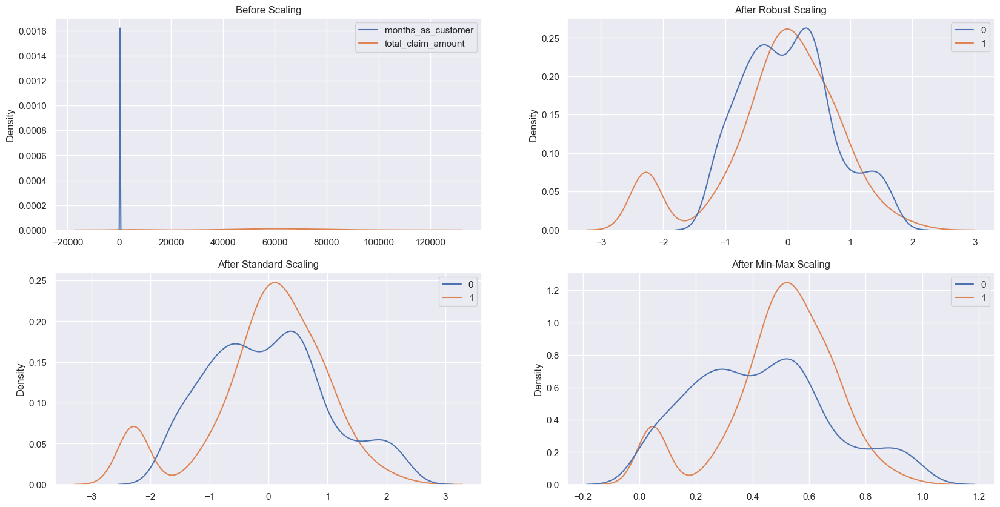

In [111]:
from sklearn import preprocessing
import matplotlib.pyplot as plt
import seaborn as sns

scaler = preprocessing.RobustScaler()
robust_df = scaler.fit_transform(X_standadirzed)
robust_df = pd.DataFrame(robust_df)

scaler = preprocessing.StandardScaler()
standard_df = scaler.fit_transform(X_standadirzed)
standard_df = pd.DataFrame(standard_df)

scaler = preprocessing.MinMaxScaler()
minmax_df = scaler.fit_transform(X_standadirzed)
minmax_df = pd.DataFrame(minmax_df)

fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(nrows=2, ncols=2, figsize=(20, 10))
ax1.set_title('Before Scaling')
sns.kdeplot(data=X_standadirzed, ax=ax1, color='r')
ax2.set_title('After Robust Scaling')
sns.kdeplot(data=robust_df, ax=ax2, color='b')
ax3.set_title('After Standard Scaling')
sns.kdeplot(data=standard_df, ax=ax3, color='g')
ax4.set_title('After Min-Max Scaling')
sns.kdeplot(data=minmax_df, ax=ax4, color='black')
plt.show()


In [112]:
y_sc = y_res  # Dependent variable

In [113]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_res)

In [114]:
X_scaled = pd.DataFrame(X_scaled, columns=X.columns)

In [115]:
X_scaled.head()

,months_as_customer,age,policy_deductable,umbrella_limit,insured_sex,number_of_vehicles_involved,property_damage,bodily_injuries,witnesses,total_claim_amount,...,insured_occupation_transport-moving,incident_severity_Minor Damage,incident_severity_Total Loss,incident_severity_Trivial Damage,incident_city_Columbus,incident_city_Hillsdale,incident_city_Northbend,incident_city_Northbrook,incident_city_Riverwood,incident_city_Springfield
0,1.088492,1.016312,-0.226993,-0.486497,1.209148,-0.894517,0.016142,0.057064,0.549297,0.592784,...,-0.256374,-0.612991,-0.579046,-0.214669,2.572440,-0.364328,-0.367423,-0.335775,-0.353378,-0.387233
1,0.198349,0.341479,1.467664,1.654344,1.209148,-0.894517,1.237554,-1.188471,-1.322933,-2.426040,...,-0.256374,1.631346,-0.579046,-0.214669,-0.388736,-0.364328,-0.367423,-0.335775,2.829830,-0.387233
2,-0.638385,-1.120658,1.467664,1.654344,-0.827029,1.115932,-1.205270,1.302599,1.485412,-1.084038,...,-0.256374,1.631346,-0.579046,-0.214669,2.572440,-0.364328,-0.367423,-0.335775,-0.353378,-0.387233
3,0.447589,0.229007,1.467664,2.082513,-0.827029,-0.894517,1.237554,0.057064,0.549297,0.220308,...,-0.256374,-0.612991,-0.579046,-0.214669,-0.388736,-0.364328,-0.367423,-0.335775,-0.353378,-0.387233
4,0.447589,0.004063,-0.226993,-0.486497,-0.827029,1.115932,-1.205270,-1.188471,0.549297,0.252066,...,-0.256374,-0.612991,-0.579046,-0.214669,-0.388736,-0.364328,-0.367423,-0.335775,-0.353378,-0.387233


In [116]:
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_sc, random_state = 1, stratify=y_sc)

In [117]:
models = []
models.append(('LR', LogisticRegression(solver='newton-cg', multi_class='ovr')))
models.append(('LDA', LinearDiscriminantAnalysis()))
models.append(('KNN', KNeighborsClassifier()))
models.append(('CART', DecisionTreeClassifier()))
models.append(('NB', GaussianNB()))
models.append(('SVM', SVC(gamma='auto')))
models.append(('RF', RandomForestClassifier()))

In [118]:
results = []
names = []
for name, model in models:
	kfold = StratifiedKFold(n_splits=10, random_state=1, shuffle=True)
	cv_results = cross_val_score(model, X_train, y_train, cv=kfold, scoring='recall')
	results.append(cv_results)
	names.append(name)
	print('%s: %f (%f)' % (name, cv_results.mean(), cv_results.std()))

LR: 0.777143 (0.045714)
LDA: 0.831429 (0.039279)
KNN: 0.725714 (0.097478)
CART: 0.737143 (0.069752)
NB: 0.694286 (0.075647)
SVM: 0.760000 (0.060204)
RF: 0.737143 (0.056856)


In [119]:
results = []
names = []
conf_matrices = []

for name, model in models:
    # Train the model on the entire training set
    model.fit(X_train, y_train)
    
    # Make predictions on the test set
    y_pred = model.predict(X_test)
    
    # Compute the confusion matrix
    cm = confusion_matrix(y_test, y_pred)
    conf_matrices.append(cm)
    
    # Print the confusion matrix
    print(f"Confusion matrix for {name}:")
    print(cm)

Confusion matrix for LR:
[[137  30]
 [ 31  86]]
Confusion matrix for LDA:
[[136  31]
 [ 28  89]]
Confusion matrix for KNN:
[[115  52]
 [ 33  84]]
Confusion matrix for CART:
[[124  43]
 [ 35  82]]
Confusion matrix for NB:
[[125  42]
 [ 34  83]]
Confusion matrix for SVM:
[[145  22]
 [ 35  82]]
Confusion matrix for RF:
[[145  22]
 [ 36  81]]


Using standardised techniques makes the dataset more amenable to various machine-learning algorithms, and may be favourable in some scenarios.
Looking at the recall metrics of the models, it is notable the improvement after SMOTE and standardizing.

### Models are chosen: LogisticRegression, LinearDiscriminantAnalysis, SVM (Support Vector Machine) and CART

# Logistic Regression
Logistic regression is a supervised machine learning algorithm used for classification tasks where the goal is to predict the probability that an instance belongs to a given class or not. It is a statistical algorithm which analyzes the relationship between two data factors. In logistic regression, we use the concept of the threshold value, which defines the probability of either 0 or 1. Such as values above the threshold value tend to be 1, and those below the threshold value tend to be 0 (GeeksforGeeks, 2017).

In [137]:
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, make_scorer
import time
from sklearn.metrics import classification_report

Optimising the values of the hyperparameters, for a specific task, will often lead to superior model performance and thereby help to prevent overfitting. 
Grid Search is one of the most popular choices isfor hyperparameter tuning and involves an exhaustive search through a list of all possible hyperparameter values to try. Every possible combination is tried, and then the best performing model can be selected. While this option tends to perform well, it is computationally expensive in larger datasets (Anon, 2023).
GridSearchCV is used coupled with RepeatedStratifiedKFold which is a cross-validation method. 


In [138]:
X_lr = pd.DataFrame(X_res)  # Independent variables
y_lr = pd.DataFrame(y_res)  # Dependent variable

# define models and parameters
model = LogisticRegression()
solvers = ['newton-cg', 'lbfgs', 'liblinear']
penalty = ['l2']
c_values = [100, 10, 1.0, 0.1, 0.01]

# define grid search
grid = dict(solver=solvers,penalty=penalty,C=c_values)
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
grid_search = GridSearchCV(estimator=model, param_grid=grid, n_jobs=-1, cv=cv, scoring='accuracy',error_score=0)
grid_result = grid_search.fit(X_lr, y_lr)

# summarize results
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
for mean, stdev, param in zip(means, stds, params):
    print("%f (%f) with: %r" % (mean, stdev, param))

Best: 0.827633 using {'C': 100, 'penalty': 'l2', 'solver': 'newton-cg'}
0.827633 (0.027524) with: {'C': 100, 'penalty': 'l2', 'solver': 'newton-cg'}
0.569466 (0.030687) with: {'C': 100, 'penalty': 'l2', 'solver': 'lbfgs'}
0.591784 (0.051720) with: {'C': 100, 'penalty': 'l2', 'solver': 'liblinear'}
0.826163 (0.027378) with: {'C': 10, 'penalty': 'l2', 'solver': 'newton-cg'}
0.572998 (0.028051) with: {'C': 10, 'penalty': 'l2', 'solver': 'lbfgs'}
0.603568 (0.073785) with: {'C': 10, 'penalty': 'l2', 'solver': 'liblinear'}
0.826445 (0.027654) with: {'C': 1.0, 'penalty': 'l2', 'solver': 'newton-cg'}
0.571518 (0.029546) with: {'C': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
0.585967 (0.045833) with: {'C': 1.0, 'penalty': 'l2', 'solver': 'liblinear'}
0.822031 (0.030298) with: {'C': 0.1, 'penalty': 'l2', 'solver': 'newton-cg'}
0.573278 (0.029750) with: {'C': 0.1, 'penalty': 'l2', 'solver': 'lbfgs'}
0.593327 (0.060954) with: {'C': 0.1, 'penalty': 'l2', 'solver': 'liblinear'}
0.752412 (0.029374) wit

In [140]:
X_lr = pd.DataFrame(X_res)  # Independent variables
y_lr = pd.DataFrame(y_res)  # Dependent variable

In [141]:
y_lr.value_counts()

fraud_reported
0                 668
1                 467
Name: count, dtype: int64

In [142]:
X_train, X_test, y_train, y_test = train_test_split(X_lr, y_lr, test_size=0.25, random_state = 1)

In [143]:
# instantiate the model (using the tunned parameters)
logreg = LogisticRegression(C=100, solver='newton-cg', penalty= 'l2', random_state=16)

# fit the model with data
logreg.fit(X_train, y_train)

y_pred_LR = logreg.predict(X_test)

In [151]:
# import the metrics class
from sklearn import metrics

cnf_matrix_logreg = metrics.confusion_matrix(y_test, y_pred_LR)
cnf_matrix_logreg

array([[151,  28],
       [ 18,  87]], dtype=int64)

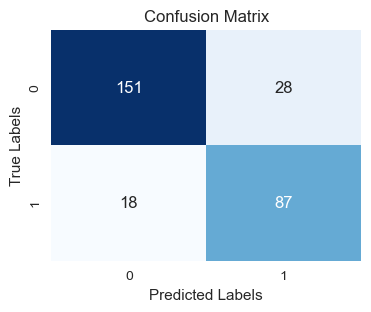

In [152]:
# Plot the confusion matrix
plt.figure(figsize=(4, 3))
sns.heatmap(cnf_matrix_logreg, annot=True, fmt='g', cmap='Blues', cbar=False)
plt.title('Confusion Matrix')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [146]:
target_names = ['No Fraud', 'Fraud reported']
print(classification_report(y_test, y_pred_LR, target_names=target_names))

                precision    recall  f1-score   support

      No Fraud       0.89      0.84      0.87       179
Fraud reported       0.76      0.83      0.79       105

      accuracy                           0.84       284
     macro avg       0.83      0.84      0.83       284
  weighted avg       0.84      0.84      0.84       284



Area Under the Receiver Operating Characteristic Curve (AUC-ROC): The ROC curve plots the true positive rate against the false positive rate at various thresholds. AUC-ROC measures the area under this curve, providing an aggregate measure of a model’s performance across different classification thresholds. It shows an 90% confidence level. 

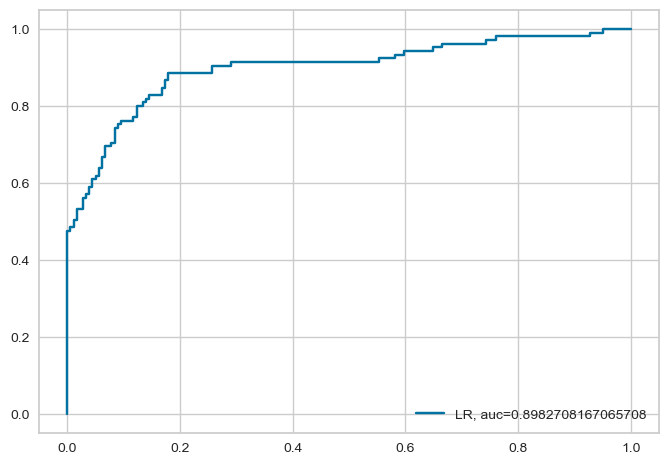

In [147]:
y_pred_proba = logreg.predict_proba(X_test)[::,1]
fpr, tpr, _ = metrics.roc_curve(y_test,  y_pred_proba)
auc = metrics.roc_auc_score(y_test, y_pred_proba)
plt.plot(fpr,tpr,label="LR, auc="+str(auc))
plt.legend(loc=4)
plt.show()

In [148]:
LR_test_acc = accuracy_score(y_test, y_pred_LR)#Saving to compare model results at the end
LR_test_prec = precision_score(y_test,y_pred_LR)
LR_test_recall = recall_score(y_test,y_pred_LR)
LR_test_f1_score = f1_score(y_test,y_pred_LR)

Cross-validation is particularly crucial in scenarios involving imbalanced datasets to ensure reliable accuracy estimates.

In [149]:
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import cross_val_score

skf = StratifiedKFold(n_splits=5)

# Use the cross_val_score method to perform cross-validation
scores = cross_val_score(logreg, X_lr, y_lr, cv=skf)

# Print Results
print("Mean Accuracy:", scores.mean())
print("Standard Deviation of Accuracy:", scores.std())

Mean Accuracy: 0.814977973568282
Standard Deviation of Accuracy: 0.09015243871215142


Train and test are both aligned in their accuracy score.

In [150]:
print("Logistic Regression train performance = ", accuracy_score(y_train,logreg.predict(X_train)))
print("Logistic Regression test performance = ", accuracy_score(y_test,logreg.predict(X_test)))

Logistic Regression train performance =  0.8331374853113983
Logistic Regression test performance =  0.8380281690140845


The image below illustrates the change in accuracy across different selected parameters for C.

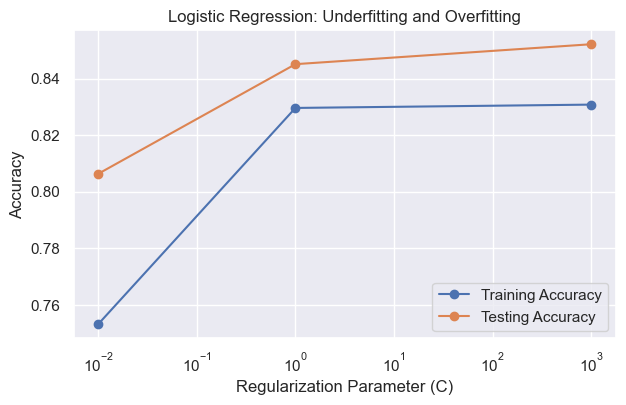

In [133]:
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, roc_auc_score

reg_params = [0.01, 1, 1000]
train_accuracy = []
test_accuracy = []

for C in reg_params:

    model = LogisticRegression(C=C, random_state=42,solver='newton-cg', max_iter=1000)
    model.fit(X_train, y_train)

    # Predictions on training set
    y_train_pred = model.predict(X_train)
    train_accuracy.append(accuracy_score(y_train, y_train_pred))

    # Predictions on testing set
    y_test_pred = model.predict(X_test)
    test_accuracy.append(accuracy_score(y_test, y_test_pred))

# Plotting the results
plt.figure(figsize=(7, 4))
plt.plot(reg_params, train_accuracy, marker='o', label='Training Accuracy')
plt.plot(reg_params, test_accuracy, marker='o', label='Testing Accuracy')
plt.xscale('log')
plt.xlabel('Regularization Parameter (C)')
plt.ylabel('Accuracy')
plt.title('Logistic Regression: Underfitting and Overfitting')
plt.legend()
plt.show()

### Evaluation results using PyCaret

It uses as default 30% as test and 70% for train

In [167]:
from pycaret.classification import *
exp_name = setup(data = X_res,  target = y_res)

# create model
lr = create_model('lr', C=100, solver='newton-cg', penalty= 'l2')

# launch evaluate widget
evaluate_model(lr)

,Description,Value
0,Session id,6865
1,Target,fraud_reported
2,Target type,Binary
3,Original data shape,"(1135, 36)"
4,Transformed data shape,"(1135, 36)"
5,Transformed train set shape,"(794, 36)"
6,Transformed test set shape,"(341, 36)"
7,Numeric features,35
8,Preprocess,True
9,Imputation type,simple


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8625,0.9084,0.7879,0.8667,0.8254,0.7124,0.7146
1,0.7875,0.8156,0.7576,0.7353,0.7463,0.5635,0.5637
2,0.8250,0.8311,0.7273,0.8276,0.7742,0.6323,0.6358
3,0.7500,0.8356,0.6970,0.6970,0.6970,0.4842,0.4842
4,0.7975,0.8360,0.6667,0.8148,0.7333,0.5727,0.5802
5,0.8354,0.8663,0.7273,0.8571,0.7869,0.6543,0.6602
6,0.8101,0.8538,0.7273,0.8000,0.7619,0.6046,0.6065
7,0.7468,0.8258,0.7188,0.6765,0.6970,0.4799,0.4806
8,0.7848,0.8637,0.7500,0.7273,0.7385,0.5557,0.5559


interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

,Description,Value
0,Session id,3388
1,Target,fraud_reported
2,Target type,Binary
3,Original data shape,"(1135, 36)"
4,Transformed data shape,"(1135, 36)"
5,Transformed train set shape,"(794, 36)"
6,Transformed test set shape,"(341, 36)"
7,Numeric features,35
8,Preprocess,True
9,Imputation type,simple


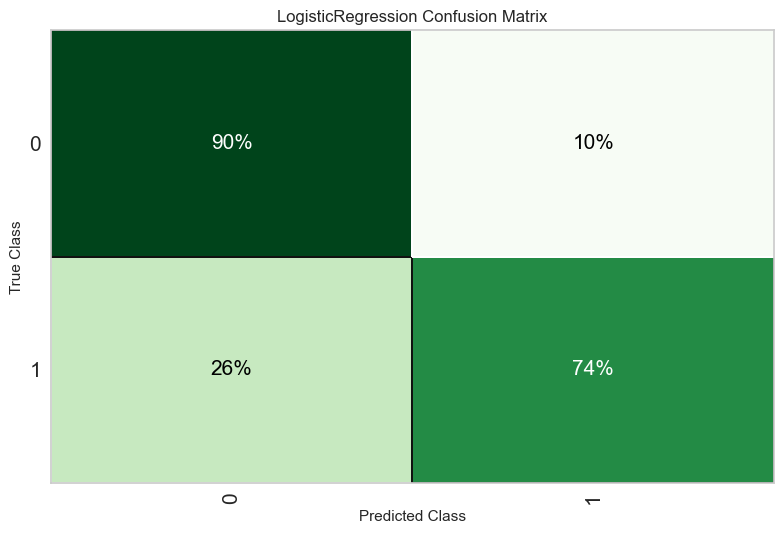

In [165]:
# init setup
from pycaret.classification import *
clf1 = setup(data = X_res, target = y_res)

# plot model
plot_model(lr, plot = 'confusion_matrix', plot_kwargs = {'percent' : True})

### Lime LR
In order to build trust in the model, we run multiple cross-validations and perform hold-out set validation. These simulations give an aggregated view of model performance over unknown data. This does not help in understanding why some of our predictions are correct while others are wrong nor can we trace our model’s decision path. In other words, we cannot understand its learning or figure out its spurious conclusions.
LIME ( Local Interpretable Model-agnostic Explanations )is a novel explanation technique that explains the prediction of any classifier in an interpretable and faithful manner by learning an interpretable model locally around the prediction (Sharma, 2018) 


In [142]:
import lime
from lime import lime_tabular
explainer = lime.lime_tabular.LimeTabularExplainer(X_train.values, 
                                                   feature_names=X_train.columns, class_names=[0, 1], discretize_continuous=True)

Using LIME I selected one instance to analyse the model explainer. The image below shows the features that contributed to being classified as fraudulent. It suggests that the ”total_claim amount” is the most relevant. 

In [143]:
# Select a specific instance for explanation
instance_idx = 126
exp = explainer.explain_instance(X_test.loc[instance_idx].values, logreg.predict_proba)
# Visualize the explanation
# print("The column analysis of ",X_test.iloc[instance_idx])
exp.show_in_notebook(show_table=True, show_all=False)

In [144]:
y_test.loc[instance_idx]

fraud_reported    1
Name: 126, dtype: int32

On the other hand, when analysing one instance classified as non-fraudulent, the most important features are "vehicle claim" and “injury claim”:

In [145]:
exp = explainer.explain_instance(X_test.loc[120].values, logreg.predict_proba)
# Visualize the explanation
# print("The column analysis of ",X_test.iloc[instance_idx])
exp.show_in_notebook(show_table=True, show_all=False)

In [146]:
explainer_lime = lime_tabular.LimeTabularExplainer(
    X_train.values,
    feature_names=X_lr.columns,
    class_names=['N', 'reported as fraudulent'],
)

exp = explainer_lime.explain_instance(
    X_train.iloc[126].values, logreg.predict_proba
)

The image below explains the predicted claim at index 126. It illustrates that for each feature, there is a range of Lime values, which cumulatively contribute to determining the predictive class.

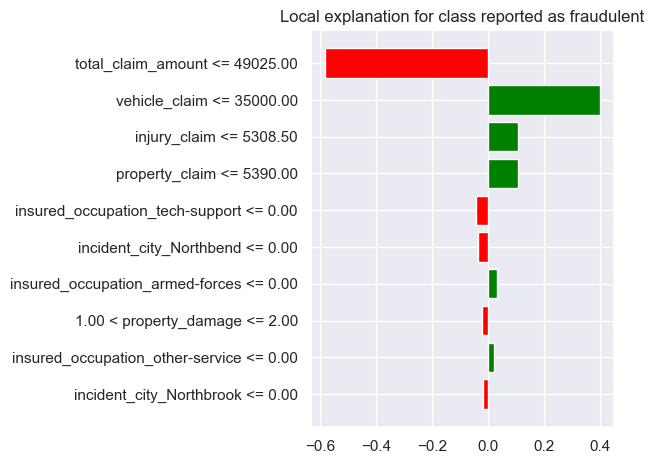

In [147]:
fig = exp.as_pyplot_figure()
fig.tight_layout()

### SHAP Logistic Regression
SHAP (SHapley Additive exPlanations) values offer an explanation for machine learning model outputs by employing a game theoretic approach. Each feature is assigned an importance value, representing its contribution to the final prediction. These values illustrate how each feature influences predictions, their significance relative to others, and the interplay between features. Positive SHAP values indicate a positive impact on predictions, while negative values suggest a negative impact, with magnitude indicating the strength of the effect. They provide a consistent and objective means of understanding feature impact in machine learning models.

Understanding a linear model typically involves examining the coefficients assigned to each feature. These coefficients indicate how the model's output changes with variations in input features. However, relying solely on coefficients to gauge feature importance has limitations. Coefficients are influenced by the scale of input features, meaning a larger coefficient doesn't necessarily signify greater importance. For instance, if we measure a home's age in minutes rather than years, the coefficient for the age feature would be minuscule despite its significance. Thus, the magnitude of a coefficient alone isn't a reliable indicator of feature importance in a linear model. In the dataset, the "total claim amount" might appear as the most important feature due to its significantly higher numerical value compared to other features. However, this doesn't necessarily mean it's the most important feature in influencing the model's output. Similar to the issue with coefficients, the scale of the feature can skew its perceived importance. Therefore, solely considering the numerical magnitude of "total claim amount" could lead to misleading conclusions about its actual significance in the model.


In [149]:
import shap

In [150]:
explainer = shap.Explainer(logreg.predict, X_test)

In [151]:
shap_values = explainer.shap_values(X_test)

PermutationExplainer explainer: 285it [00:11,  3.90it/s]                                                               


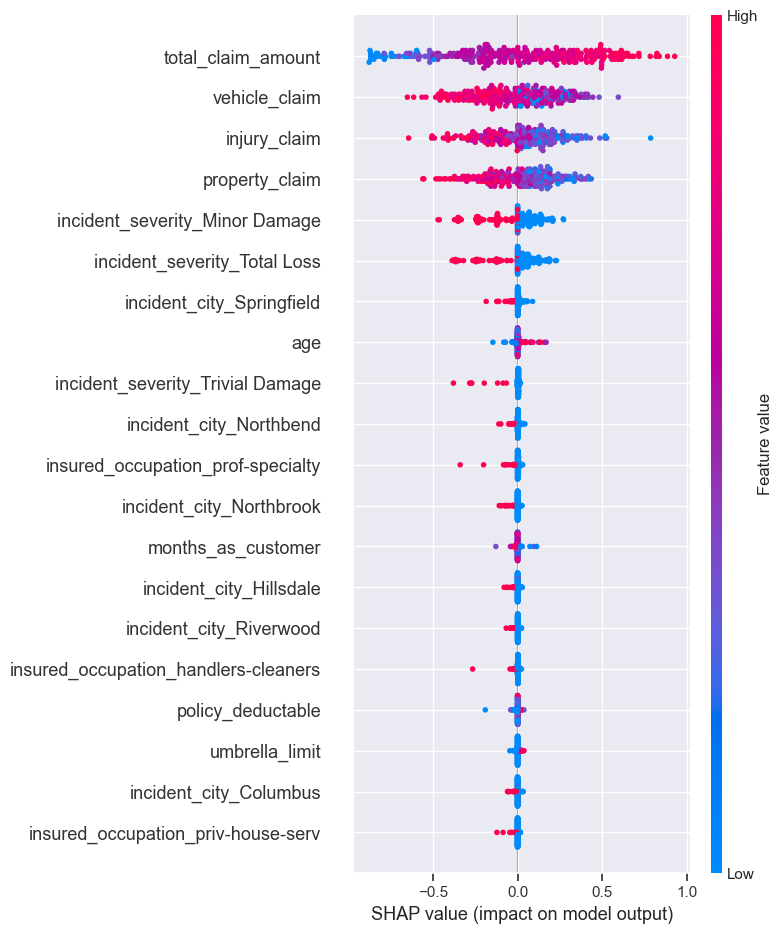

In [152]:
shap.summary_plot(shap_values, X_test)

In [153]:
X100 = shap.utils.sample(X_test, 100) # 100 instances for use as the background distribution

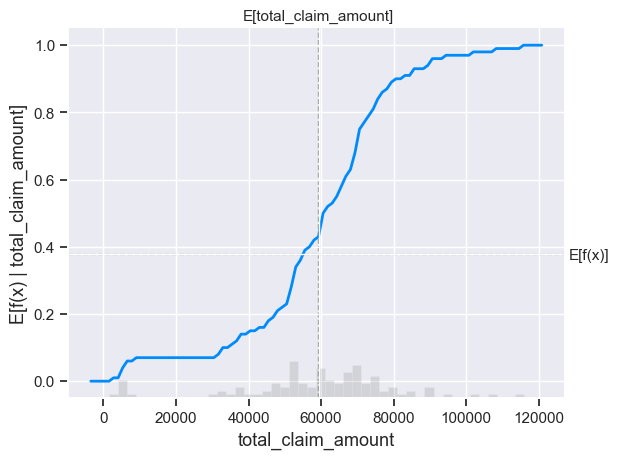

In [154]:
shap.partial_dependence_plot(
    "total_claim_amount", logreg.predict, X100, ice=False,
    model_expected_value=True, feature_expected_value=True)

In [155]:
X_test.iloc[20]

months_as_customer                        237
age                                        41
policy_deductable                        1000
umbrella_limit                              0
insured_sex                                 0
number_of_vehicles_involved                 3
property_damage                             2
bodily_injuries                             2
witnesses                                   2
total_claim_amount                      74819
injury_claim                            15233
property_claim                          12672
vehicle_claim                           46913
insured_occupation_armed-forces             0
insured_occupation_craft-repair             0
insured_occupation_exec-managerial          0
insured_occupation_farming-fishing          0
insured_occupation_handlers-cleaners        0
insured_occupation_machine-op-inspct        0
insured_occupation_other-service            0
insured_occupation_priv-house-serv          0
insured_occupation_prof-specialty 

In [156]:
y_test.iloc[20]

fraud_reported    1
Name: 1131, dtype: int32

PermutationExplainer explainer: 285it [00:11,  4.56it/s]                                                               


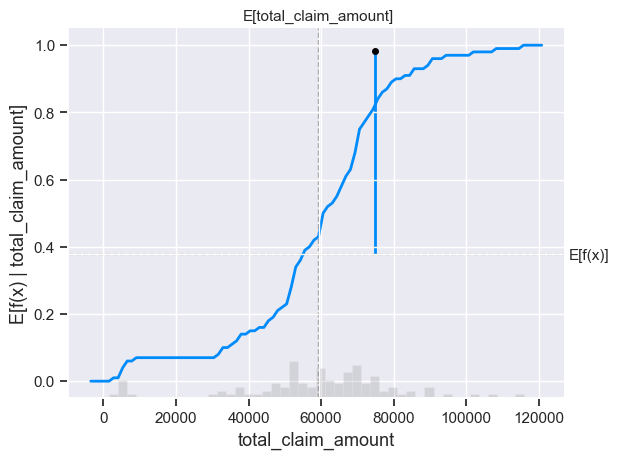

In [157]:
# compute the SHAP values for the linear model
explainer = shap.Explainer(logreg.predict, X100)
shap_values = explainer(X_test)
# make a standard partial dependence plot
sample_ind = 20
shap.partial_dependence_plot(
    "total_claim_amount", logreg.predict, X100, model_expected_value=True,
    feature_expected_value=True, ice=False,
    shap_values=shap_values[sample_ind:sample_ind+1,:])

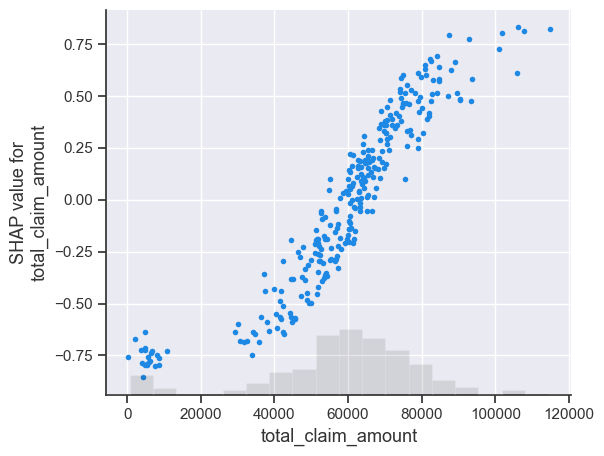

In [158]:
shap.plots.scatter(shap_values[:,"total_claim_amount"])

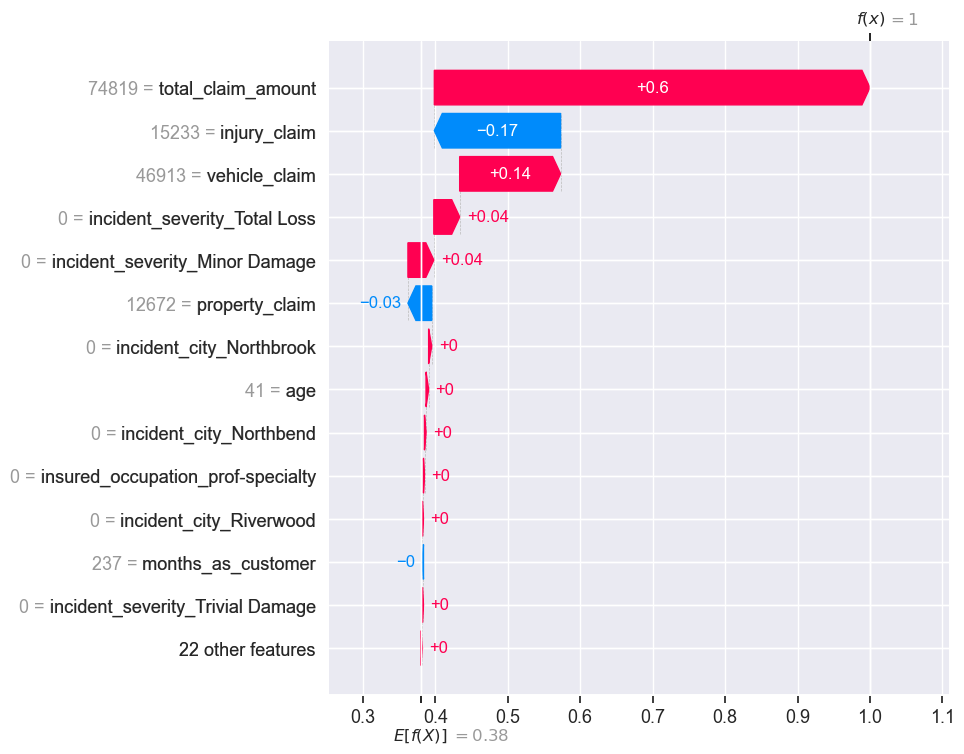

In [159]:
shap.plots.waterfall(shap_values[sample_ind], max_display=14)

PermutationExplainer explainer: 285it [00:26,  8.93it/s]                                                               


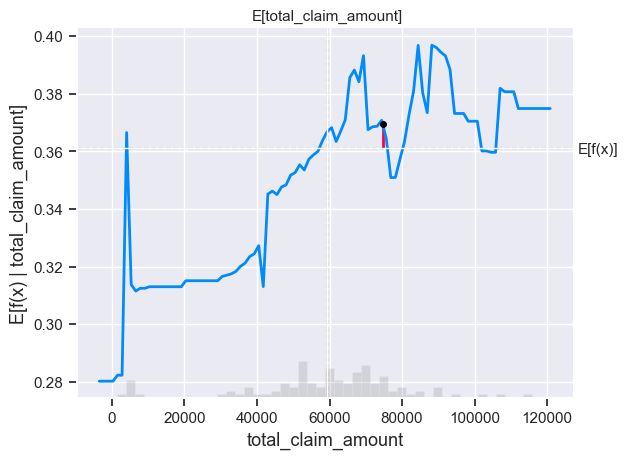

In [160]:
# fit a GAM model to the data
import interpret.glassbox
model_ebm = interpret.glassbox.ExplainableBoostingRegressor(interactions=0)
model_ebm.fit(X_test, y_test)

# explain the GAM model with SHAP
explainer_ebm = shap.Explainer(model_ebm.predict, X100)
shap_values_ebm = explainer_ebm(X_test)

# make a standard partial dependence plot with a single SHAP value overlaid
fig,ax = shap.partial_dependence_plot(
    "total_claim_amount", model_ebm.predict, X100, model_expected_value=True,
    feature_expected_value=True, show=False, ice=False,
    shap_values=shap_values_ebm[sample_ind:sample_ind+1,:])

In [161]:
#pip install interpret-core

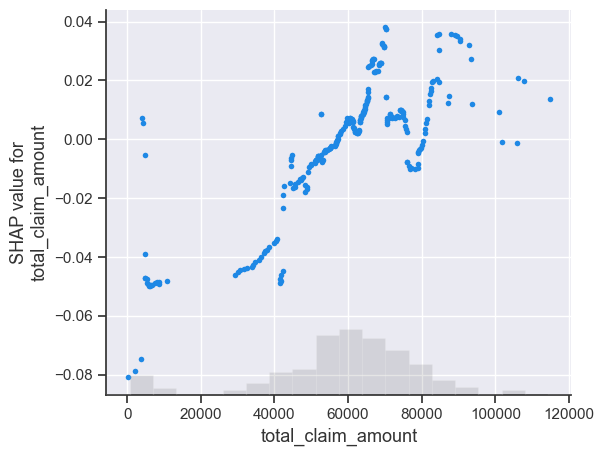

In [162]:
shap.plots.scatter(shap_values_ebm[:,"total_claim_amount"])

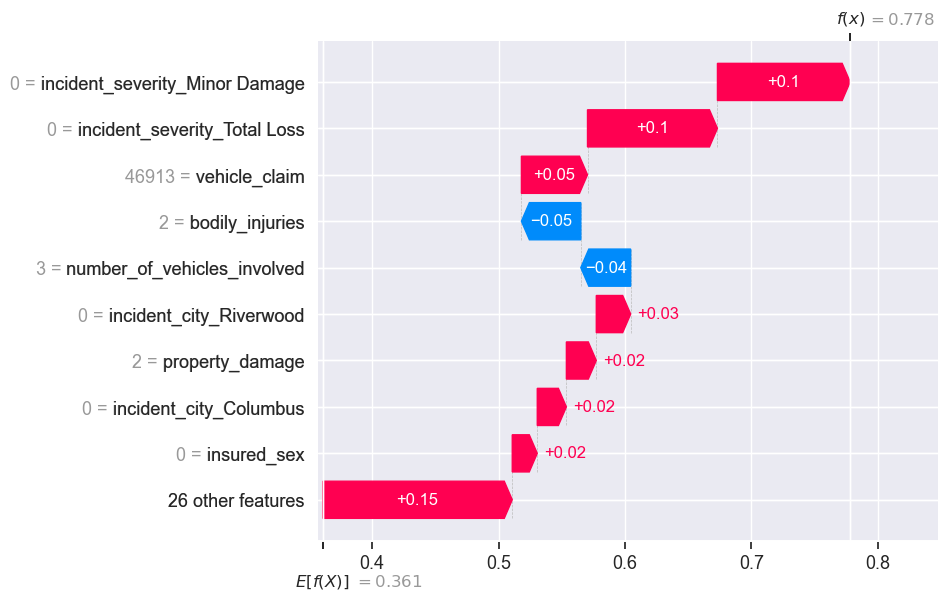

In [163]:
# the waterfall_plot shows how we get from explainer.expected_value to model.predict(X)[sample_ind]
shap.plots.waterfall(shap_values_ebm[sample_ind])

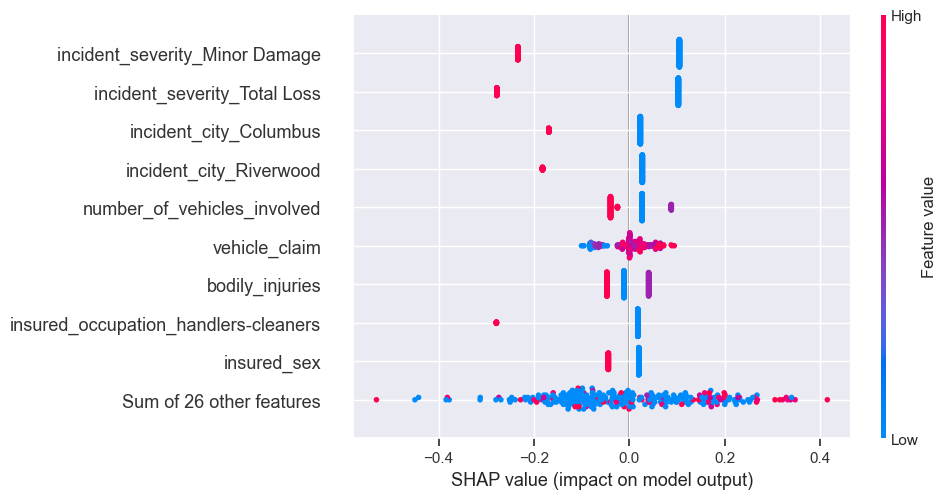

In [164]:
# the waterfall_plot shows how we get from explainer.expected_value to model.predict(X)[sample_ind]
shap.plots.beeswarm(shap_values_ebm)

In [165]:
#pip install lime

In [166]:
#pip install pdpbox

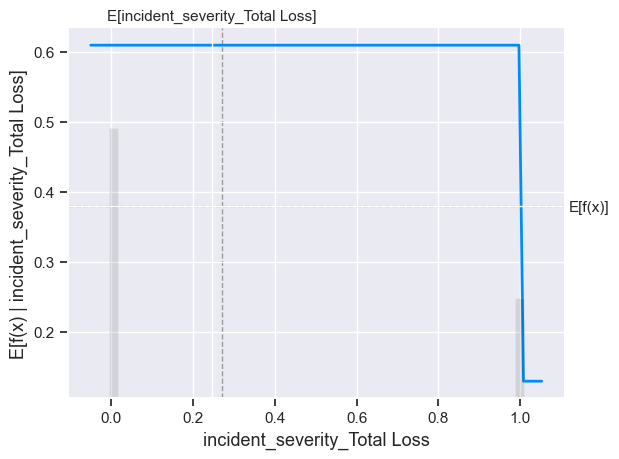

In [167]:
shap.partial_dependence_plot(
    'incident_severity_Total Loss', logreg.predict, X100, ice=False,
    model_expected_value=True, feature_expected_value=True)

# Linear Discriminant Analysis
Linear Discriminant Analysis (LDA) is a statistical technique for categorizing data into groups. It identifies patterns in features to distinguish between different classes. For instance, it may analyze characteristics like size and colour to classify fruits as apples or oranges. LDA aims to find a straight line or plane that best separates these groups while minimizing overlap within each class. By maximizing the separation between classes, it enables accurate classification of new data points. In simpler terms, LDA helps make sense of data by finding the most effective way to separate different categories, aiding tasks like pattern recognition and classification  (Dash, 2021).

In [168]:
from sklearn.model_selection import cross_validate
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, make_scorer
import time

In [169]:
X_LDA = pd.DataFrame(X_res)  # Independent variables
y_LDA = pd.DataFrame(y_res)  # Dependent variable

In [170]:
X_train, X_test, y_train, y_test = train_test_split(X_LDA, y_LDA, test_size=0.30, random_state = 1)

In [171]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.model_selection import GridSearchCV

# Define parameter grid
param_grid = {
    'solver': ['svd', 'lsqr', 'eigen'],
    'shrinkage': [None, 'auto']
}

# Create LDA classifier
lda = LinearDiscriminantAnalysis()

# Perform grid search with 5-fold cross-validation
grid_search = GridSearchCV(lda, param_grid, cv=5, scoring='recall')
grid_search.fit(X_train, y_train)

# Print best parameters and corresponding score
print("Best Parameters: ", grid_search.best_params_)
print("Best Score: ", grid_search.best_score_)

Best Parameters:  {'shrinkage': None, 'solver': 'lsqr'}
Best Score:  0.7923178226514486


In [172]:
# fit the model with data
LDA = LinearDiscriminantAnalysis(shrinkage=None, solver='eigen')
LDA.fit(X_train, y_train)

y_pred_LDA = LDA.predict(X_test)

In [173]:
cnf_matrix_LDA = metrics.confusion_matrix(y_test, y_pred_LDA)
cnf_matrix_LDA

array([[175,  36],
       [ 16, 114]], dtype=int64)

In [174]:
target_names = ['No Fraud', 'Fraud reported']
print(classification_report(y_test, y_pred_LDA, target_names=target_names))

                precision    recall  f1-score   support

      No Fraud       0.92      0.83      0.87       211
Fraud reported       0.76      0.88      0.81       130

      accuracy                           0.85       341
     macro avg       0.84      0.85      0.84       341
  weighted avg       0.86      0.85      0.85       341



In [175]:
fpr, tpr, threshold = metrics.roc_curve(y_test, y_pred_LDA)

#calculating area under the curve(AUC)
auc = metrics.auc(fpr, tpr)
auc

0.8531534815895006

Text(0, 0.5, 'True Positive Rate')

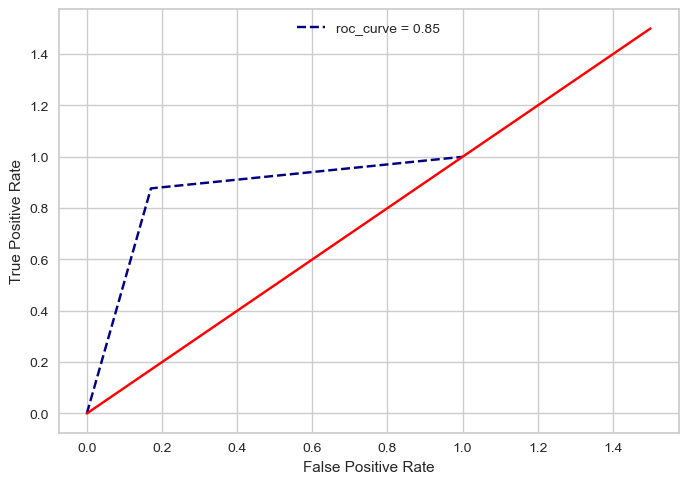

In [176]:
#plotting ROC curve using above terminologies
plt.title("Linear Discriminant Analysis")
 
plt.clf()
 
#plotting for roc curve
plt.plot(fpr, tpr, color="navy", linestyle="--", label = "roc_curve = %0.2f"% auc)
plt.legend(loc = "upper center")
 
#assigning the axis values
plt.plot([0,1.5], [0,1.5], ls = '-', color="red")
 
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")

In [177]:
## run stratified k-fold cross validation ##
scoring_metrics = {'accuracy' : make_scorer(accuracy_score), 
                   'precision': make_scorer(precision_score),
                   'recall': make_scorer(recall_score),
                   'f1': make_scorer(f1_score)}
start_time = time.time()
LDA_Scores = cross_validate(LDA,X_LDA,y_LDA,cv=StratifiedKFold(10),scoring=scoring_metrics)
print('Time duration of Stratified K-fold CV computation: ',time.time()-start_time)
#report results
print('Mean accuracy: %.2f' % np.mean(LDA_Scores['test_accuracy']))
print('Mean precision: %.2f' % np.mean(LDA_Scores['test_precision']))
print('Mean recall: %.2f' % np.mean(LDA_Scores['test_recall']))
print('Mean f1: %.2f' % np.mean(LDA_Scores['test_f1']))

Time duration of Stratified K-fold CV computation:  0.44113612174987793
Mean accuracy: 0.82
Mean precision: 0.78
Mean recall: 0.80
Mean f1: 0.78


In [178]:
LDA_test_acc = accuracy_score(y_test, y_pred_LDA)#Saving to compare model results at the end
LDA_test_prec = precision_score(y_test,y_pred_LDA)
LDA_test_recall = recall_score(y_test,y_pred_LDA)
LDA_test_f1_score = f1_score(y_test,y_pred_LDA)

### Evaluating results using PyCaret

In [179]:
from pycaret.classification import *
exp_name_LDA = setup(data = X_res,  target = y_res)

# create model
lda_classification = create_model('lda', shrinkage=None, solver='eigen')

# launch evaluate widget
evaluate_model(lda_classification)

,Description,Value
0,Session id,3063
1,Target,fraud_reported
2,Target type,Binary
3,Original data shape,"(1135, 36)"
4,Transformed data shape,"(1135, 36)"
5,Transformed train set shape,"(794, 36)"
6,Transformed test set shape,"(341, 36)"
7,Numeric features,35
8,Preprocess,True
9,Imputation type,simple


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8125,0.8839,0.8485,0.7368,0.7887,0.6217,0.6267
1,0.7875,0.8691,0.6970,0.7667,0.7302,0.5556,0.5573
2,0.7875,0.8304,0.7273,0.7500,0.7385,0.5596,0.5598
3,0.8250,0.8698,0.7879,0.7879,0.7879,0.6389,0.6389
4,0.7595,0.8125,0.7188,0.6970,0.7077,0.5035,0.5036
5,0.8354,0.9016,0.7812,0.8065,0.7937,0.6569,0.6571
6,0.7975,0.9089,0.8125,0.7222,0.7647,0.5880,0.5911
7,0.8354,0.9025,0.6970,0.8846,0.7797,0.6513,0.6631
8,0.8861,0.9163,0.8182,0.9000,0.8571,0.7628,0.7652


interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

## SHAP LDA

When comparing SHAP values between LR and LDA, it becomes apparent that due to their distinct processes, they tend to exhibit varying degrees of feature importance

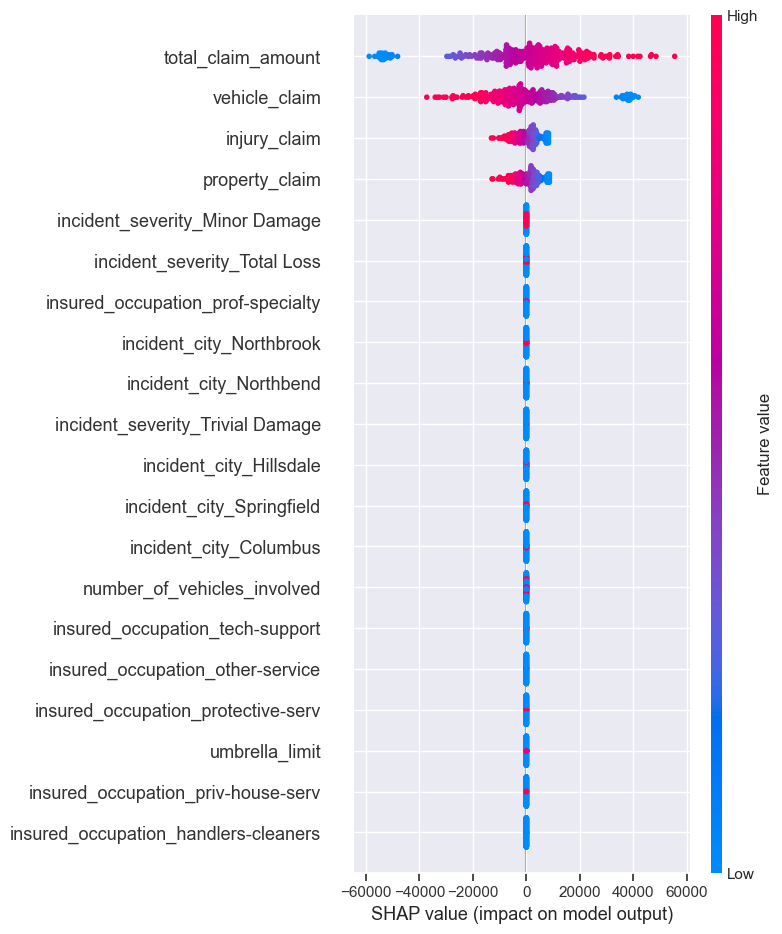

In [180]:
# Initialize explainer with the trained model and data
explainer = shap.Explainer(LDA, X_test)

# Calculate SHAP values
shap_values = explainer.shap_values(X_test)

# Visualize SHAP values with feature names
shap.summary_plot(shap_values, X_test)

In [181]:
X100 = shap.utils.sample(X_LDA, 100) # 100 instances for use as the background distribution

In [182]:
# compute SHAP values
explainer = shap.Explainer(LDA, X_LDA)
shap_values = explainer(X_LDA)

# set a display version of the data to use for plotting (has string values)
shap_values.display_data = X_LDA.values 

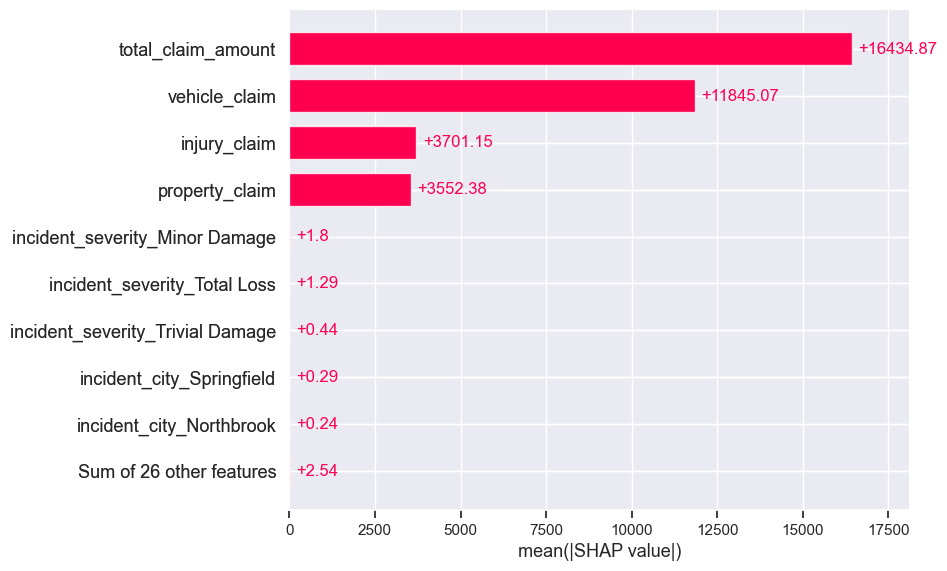

In [183]:
shap.plots.bar(shap_values)

PermutationExplainer explainer: 1136it [00:43, 19.22it/s]                                                              


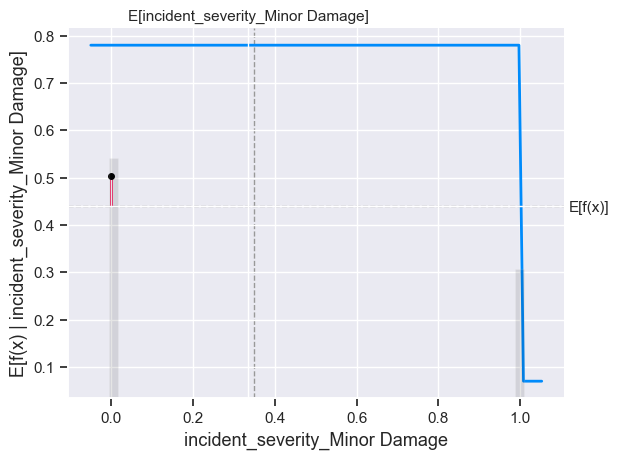

In [184]:
# compute the SHAP values for the linear model
explainer = shap.Explainer(LDA.predict, X100)
shap_values = explainer(X_LDA)

# make a standard partial dependence plot
sample_ind = 20
shap.partial_dependence_plot(
    'incident_severity_Minor Damage', LDA.predict, X100, model_expected_value=True,
    feature_expected_value=True, ice=False,
    shap_values=shap_values[sample_ind:sample_ind+1,:])

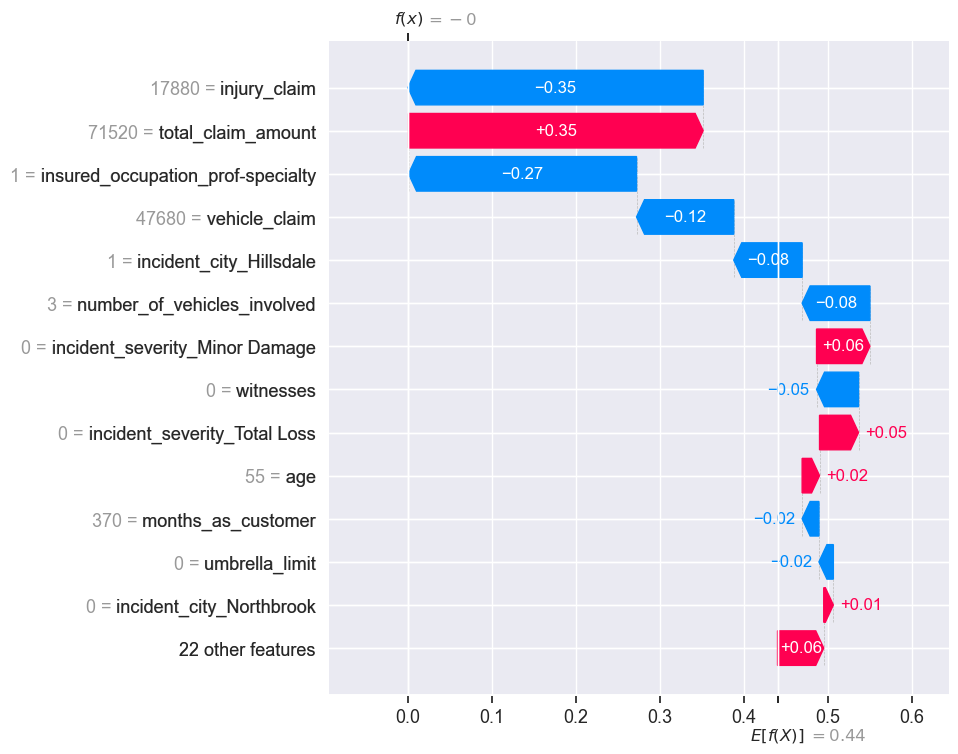

In [185]:
shap.plots.waterfall(shap_values[sample_ind], max_display=14)

The image below demonstrates that 'incident severity Minor Damage' carries significant weight in non-fraudulent predictions, but its influence diminishes considerably in fraudulent cases.

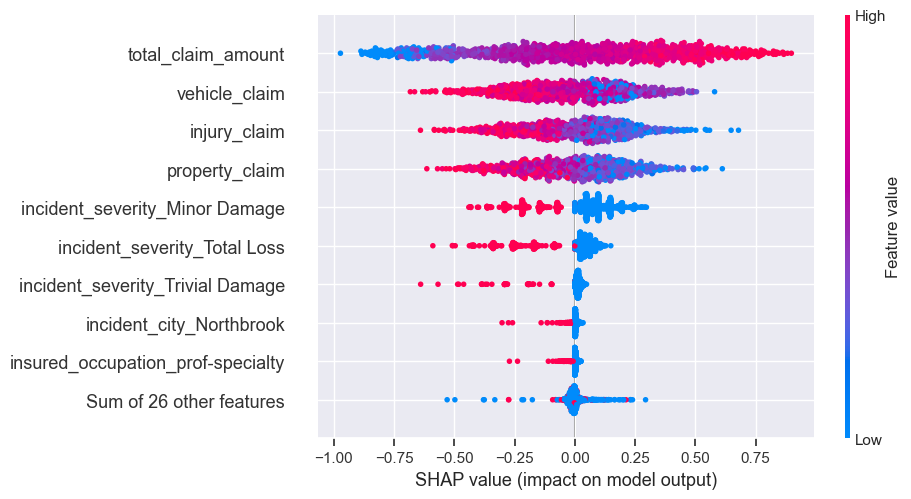

In [186]:
shap.plots.beeswarm(shap_values)

A SHAP heatmap visualizes the impact of features on model predictions. The color intensity at each intersection indicates the feature's contribution to the prediction.

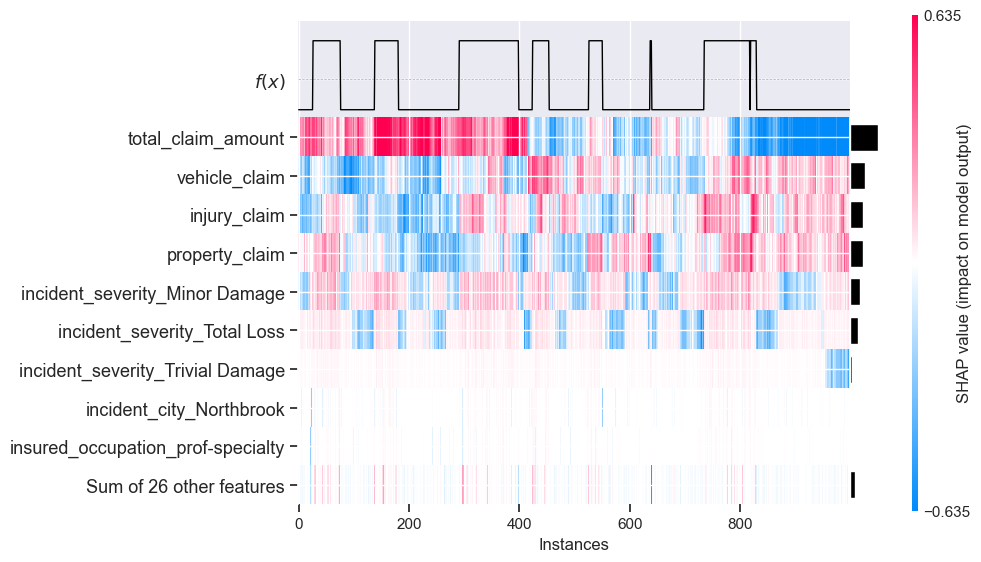

In [187]:
shap.plots.heatmap(shap_values[:1000])

To understand how a single feature effects the output of the model we can plot the SHAP value of that feature vs. the value of the feature for all the examples in a dataset. Since SHAP values represent a feature's responsibility for a change in the model output, the plot below represents the change in predicted fraudulent claims as the 'incidenty severity' changes. Vertical dispersion at a single value of 'incidenty severity' represents interaction effects with other features. To help reveal these interactions we can color by another feature. If we pass the whole explanation tensor to the color argument the scatter plot will pick the best feature to color by. In this case it picks 'incidenty severity total loss'.

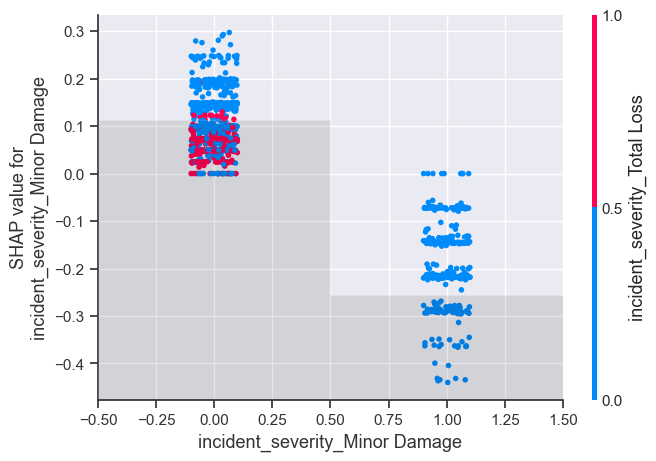

In [188]:
# create a dependence scatter plot to show the effect of a single feature across the whole dataset
shap.plots.scatter(shap_values[:, 'incident_severity_Minor Damage'], color=shap_values)

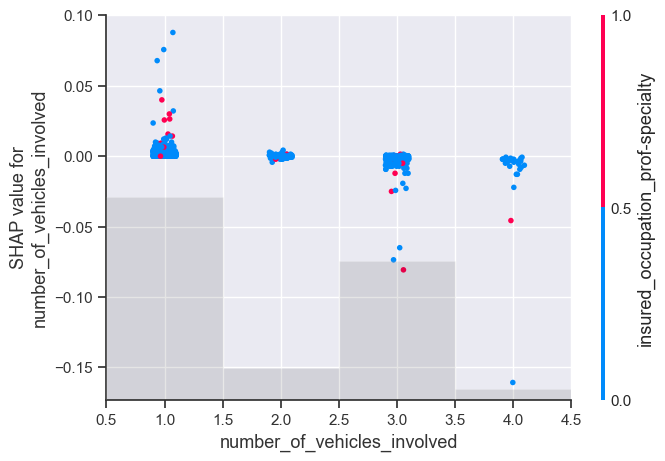

In [189]:
shap.plots.scatter(shap_values[:, 'number_of_vehicles_involved'], color=shap_values)

# SVM (Support Vector Classification)
In the mathematical context, an SVM refers to a set of ML algorithms that use kernel methods to transform data features by employing kernel functions. Kernel functions rely on the process of mapping complex datasets to higher dimensions in a manner that makes data point separation easier. The function simplifies the data boundaries for non-linear problems by adding higher dimensions to map complex data points (Spiceworks, n.d.).
Since SVM is sensitive to outliers, the scaled dataset is used. 


In [190]:
X_SVM = pd.DataFrame(X_scaled)  # Independent variables
y_SVM = pd.DataFrame(y_res)  # Dependent variable

In [191]:
X_train, X_test, y_train, y_test = train_test_split(X_SVM, y_SVM, test_size=0.25, random_state = 1)

In [192]:
#Import svm model
from sklearn import svm

#Create a svm Classifier
model_svc = SVC()
#Train the model using the training sets
model_svc.fit(X_train,y_train)

#Predict the response for test dataset
y_pred_SVC_noh = model_svc.predict(X_test) #predictions before hyperparameter tuned

In [193]:
target_names = ['No Fraud', 'Fraud reported']
print(classification_report(y_test, y_pred_SVC_noh, target_names=target_names))

                precision    recall  f1-score   support

      No Fraud       0.88      0.88      0.88       179
Fraud reported       0.80      0.79      0.79       105

      accuracy                           0.85       284
     macro avg       0.84      0.84      0.84       284
  weighted avg       0.85      0.85      0.85       284



In [194]:
from sklearn.model_selection import GridSearchCV

#Hyperparameter Tuning
params = {
    'C':[50,10,1.0, 0.1, 0.01],
    'kernel': ['poly', 'rbf', 'sigmoid'],
    'gamma': ['scale']
}

grid_search_svc = GridSearchCV(model_svc,params,cv=5,n_jobs=-1,verbose=1)
grid_search_svc.fit(X_train, y_train)

Fitting 5 folds for each of 15 candidates, totalling 75 fits


GridSearchCV(cv=5, error_score=nan,
             estimator=SVC(C=1.0, break_ties=False, cache_size=200,
                           class_weight=None, coef0=0.0,
                           decision_function_shape='ovr', degree=3,
                           gamma='scale', kernel='rbf', max_iter=-1,
                           probability=False, random_state=None, shrinking=True,
                           tol=0.001, verbose=False),
             n_jobs=-1,
             param_grid={'C': [50, 10, 1.0, 0.1, 0.01], 'gamma': ['scale'],
                         'kernel': ['poly', 'rbf', 'sigmoid']},
             pre_dispatch='2*n_jobs', refit=True, return_train_score=False,
             scoring=None, verbose=1)

In [195]:
print(grid_search_svc.best_params_)

{'C': 1.0, 'gamma': 'scale', 'kernel': 'sigmoid'}


In [196]:
best_svc = grid_search_svc.best_estimator_

In [197]:
from sklearn.pipeline import make_pipeline
SVCmodel = make_pipeline(SVC(C=1.0, kernel='sigmoid', verbose=False, max_iter=-1, decision_function_shape='ovr', probability=True, random_state=22))
SVCmodel.fit(X_train, y_train)

Pipeline(memory=None,
         steps=[('svc',
                 SVC(C=1.0, break_ties=False, cache_size=200, class_weight=None,
                     coef0=0.0, decision_function_shape='ovr', degree=3,
                     gamma='scale', kernel='sigmoid', max_iter=-1,
                     probability=True, random_state=22, shrinking=True,
                     tol=0.001, verbose=False))],
         verbose=False)

In [198]:
from sklearn.metrics import accuracy_score
print("Kernel SVC train performance = ", accuracy_score(y_train,SVCmodel.predict(X_train)))
print("Kernel SVC test performance = ", accuracy_score(y_test,SVCmodel.predict(X_test)))

Kernel SVC train performance =  0.8096357226792009
Kernel SVC test performance =  0.8380281690140845


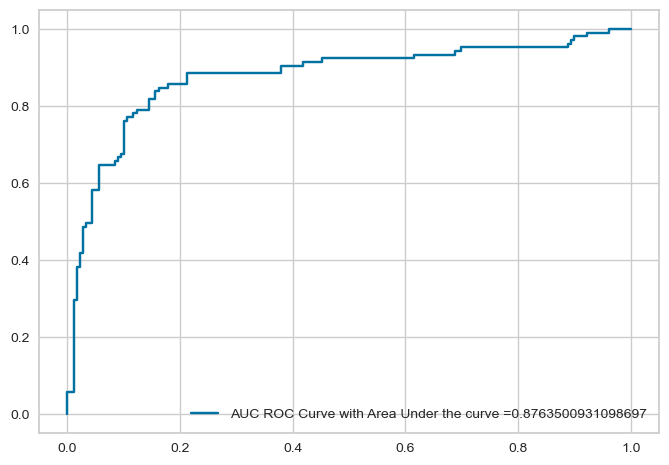

In [199]:
from sklearn.metrics import roc_auc_score,roc_curve
y_pred_proba = SVCmodel.predict_proba (X_test) [:, 1]
fpr, tpr, thresholds = roc_curve (y_test, y_pred_proba)
auc = roc_auc_score(y_test, y_pred_proba)
plt.plot(fpr,tpr,label="AUC ROC Curve with Area Under the curve ="+str(auc))
plt.legend (loc=4)
plt.show()

In [200]:
y_pred_proba

array([0.86419547, 0.20969626, 0.11746576, 0.57366847, 0.19515535,
       0.84540117, 0.07482871, 0.86070508, 0.08113346, 0.15081729,
       0.14013836, 0.77753778, 0.10093851, 0.1428131 , 0.16605901,
       0.09511698, 0.17422145, 0.11404668, 0.18185201, 0.11489639,
       0.8157606 , 0.29125969, 0.12087769, 0.10959245, 0.7334716 ,
       0.25885472, 0.12345132, 0.75242408, 0.17147688, 0.29332063,
       0.1035283 , 0.84756033, 0.75227474, 0.14724099, 0.14347372,
       0.83392462, 0.15087106, 0.12595583, 0.16209288, 0.1429302 ,
       0.83733889, 0.81651592, 0.61295006, 0.33779469, 0.87558384,
       0.1078983 , 0.74374963, 0.08071576, 0.67804106, 0.16069223,
       0.16466024, 0.21933715, 0.8839457 , 0.66286468, 0.35902357,
       0.09916147, 0.67604612, 0.15355849, 0.73922066, 0.84388895,
       0.68245231, 0.11251806, 0.07458121, 0.82336387, 0.81706339,
       0.71793239, 0.11913906, 0.10956011, 0.75479765, 0.13183155,
       0.15268956, 0.07874806, 0.11757221, 0.87101857, 0.10327

In [201]:
y_pred_SVC =SVCmodel.predict(X_test)

In [202]:
y_pred_SVC

array([1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0,
       1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1,
       0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1,
       1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0,
       1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0,
       0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0,
       1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1,
       0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0,
       0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0,
       1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1,
       0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0])

In [203]:
SVC_test_acc = accuracy_score(y_test, y_pred_SVC) #Saving to compare model results at the end
SVC_test_prec = precision_score(y_test,y_pred_SVC)
SVC_test_recall = recall_score(y_test,y_pred_SVC)
SVC_test_f1_score = f1_score(y_test,y_pred_SVC)

In [204]:
target_names = ['No Fraud', 'Fraud reported']
print(classification_report(y_test, y_pred_SVC, target_names=target_names))

                precision    recall  f1-score   support

      No Fraud       0.90      0.83      0.87       179
Fraud reported       0.75      0.85      0.79       105

      accuracy                           0.84       284
     macro avg       0.83      0.84      0.83       284
  weighted avg       0.85      0.84      0.84       284



In [205]:
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import cross_val_score

skf = StratifiedKFold(n_splits=5)

# Use the cross_val_score method to perform cross-validation
scores = cross_val_score(SVCmodel, X_SVM, y_SVM, cv=skf)

# Print Results
print("Mean Accuracy:", scores.mean())
print("Standard Deviation of Accuracy:", scores.std())


Mean Accuracy: 0.8220264317180617
Standard Deviation of Accuracy: 0.06626113013907722


In [206]:
from yellowbrick.classifier import (ConfusionMatrix, ROCAUC, ClassificationReport, 
ClassPredictionError, ClassBalance)

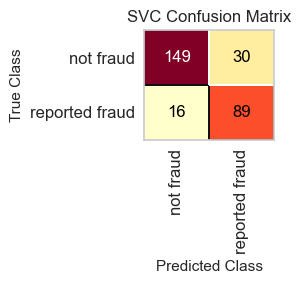

<Axes: title={'center': 'SVC Confusion Matrix'}, xlabel='Predicted Class', ylabel='True Class'>

In [207]:
mapping = {0:'not fraud', 1:'reported fraud'}

fig, ax = plt.subplots(figsize=(3,3))
cm_viz = ConfusionMatrix(SVCmodel,
                        classes=['not fraud', 'reported fraud'],
                        label_encoder=mapping)
cm_viz.score(X_test, y_test)
cm_viz.poof()

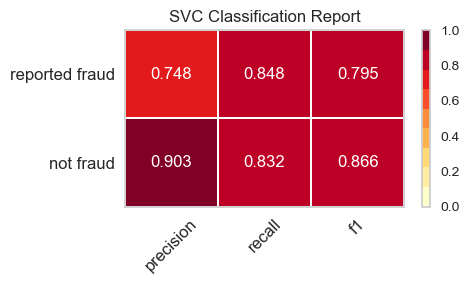

<Axes: title={'center': 'SVC Classification Report'}>

In [208]:
fig, ax = plt.subplots(figsize=(5,3))
cm_viz = ClassificationReport(SVCmodel,
                        classes=['not fraud', 'reported fraud'],
                        label_encoder=mapping)
cm_viz.score(X_test, y_test)
cm_viz.poof()

## Lime SVM

In [209]:
import lime
import lime.lime_tabular

In [210]:
explainer_svm = lime.lime_tabular.LimeTabularExplainer(X_train.values, 
                                                   feature_names=X_train.columns, class_names=[0, 1], discretize_continuous=True)

In [211]:
# Select a specific instance for explanation
instance_idx = 126
exp = explainer_svm.explain_instance(X_test.loc[instance_idx].values, SVCmodel.predict_proba)
# Visualize the explanation
# print("The column analysis of ",X_test_ohe_outlier.iloc[instance_idx])
exp.show_in_notebook(show_table=True, show_all=False)

In [212]:
exp.as_list()

[('incident_severity_Trivial Damage <= -0.21', 0.18572948682176474),
 ('incident_severity_Minor Damage <= -0.61', 0.1820839669430269),
 ('incident_severity_Total Loss <= -0.58', 0.17834094545048504),
 ('insured_occupation_other-service <= -0.24', 0.06473736952697348),
 ('insured_occupation_handlers-cleaners <= -0.22', 0.059655131677560466),
 ('insured_occupation_prof-specialty <= -0.27', 0.053030487390739664),
 ('insured_occupation_armed-forces <= -0.24', 0.051516043553985646),
 ('insured_occupation_sales <= -0.26', 0.045798018244432054),
 ('incident_city_Northbrook <= -0.34', 0.03727658884737993),
 ('incident_city_Columbus <= -0.39', 0.035894387905303464)]

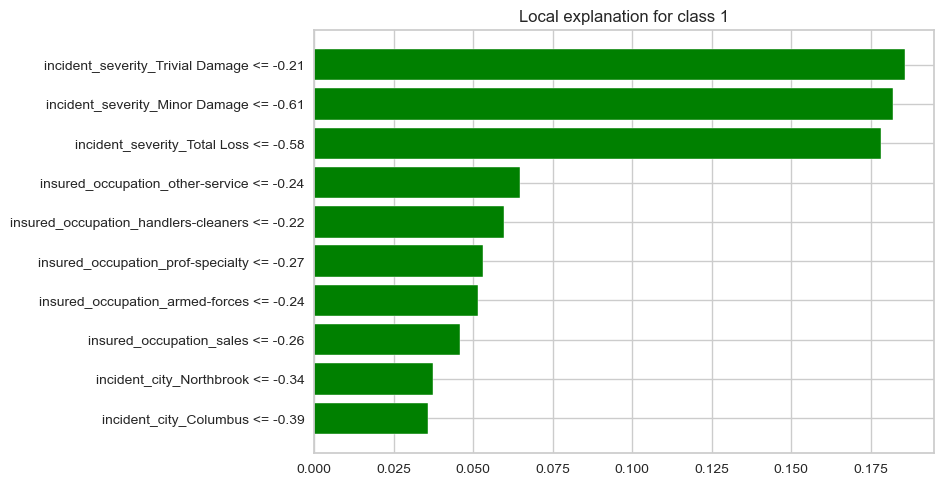

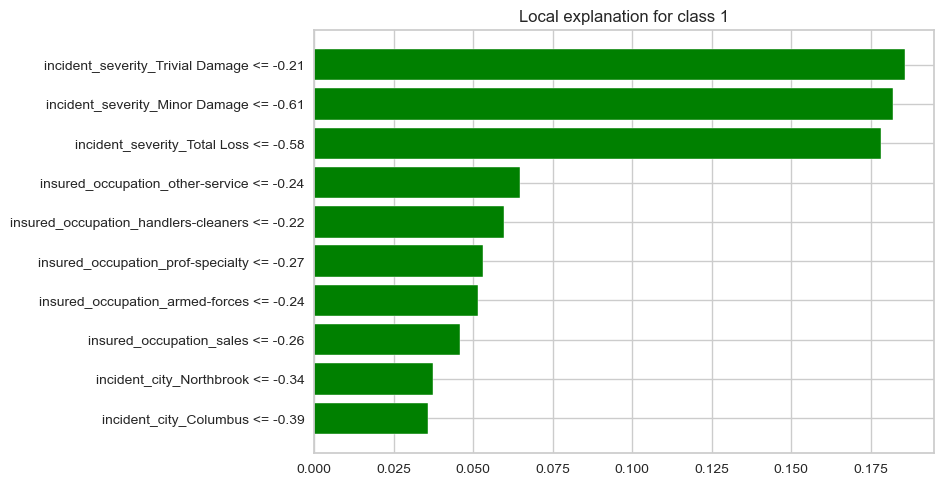

In [213]:
exp.as_pyplot_figure()

In [214]:
exp = explainer_svm.explain_instance(X_test.loc[629].values, SVCmodel.predict_proba)
# Visualize the explanation
# print("The column analysis of ",X_test_ohe_outlier.iloc[instance_idx])
exp.show_in_notebook(show_table=True, show_all=False)

In [215]:
exp.as_list()

[('-0.61 < incident_severity_Minor Damage <= 1.63', -0.18257378415248676),
 ('incident_severity_Trivial Damage <= -0.21', 0.17984509449261182),
 ('incident_severity_Total Loss <= -0.58', 0.17871563373635568),
 ('insured_occupation_other-service <= -0.24', 0.0657993679858068),
 ('insured_occupation_handlers-cleaners > -0.22', -0.05928293573408826),
 ('insured_occupation_prof-specialty <= -0.27', 0.0434602375255813),
 ('insured_occupation_armed-forces <= -0.24', 0.041458770639728),
 ('incident_city_Northbrook <= -0.34', 0.03917200743744527),
 ('insured_occupation_craft-repair <= -0.26', 0.03815340530580472),
 ('insured_occupation_exec-managerial <= -0.26', 0.036971230392749806)]

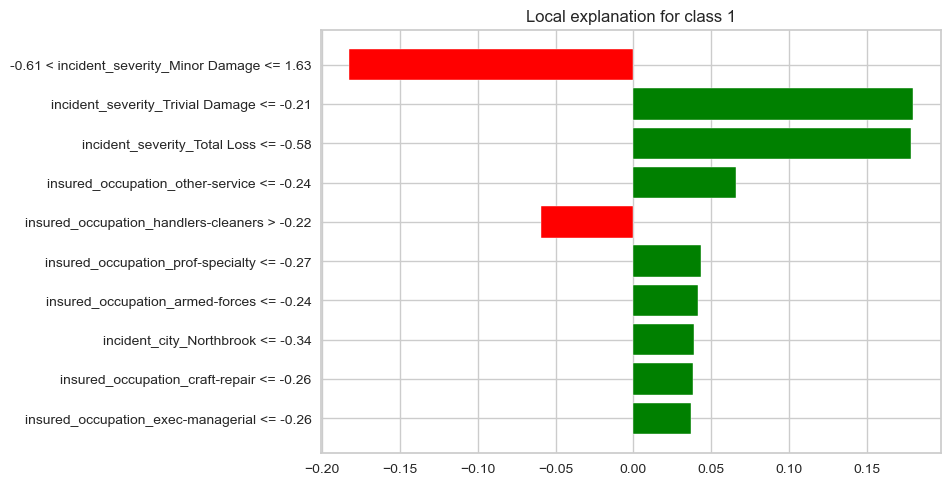

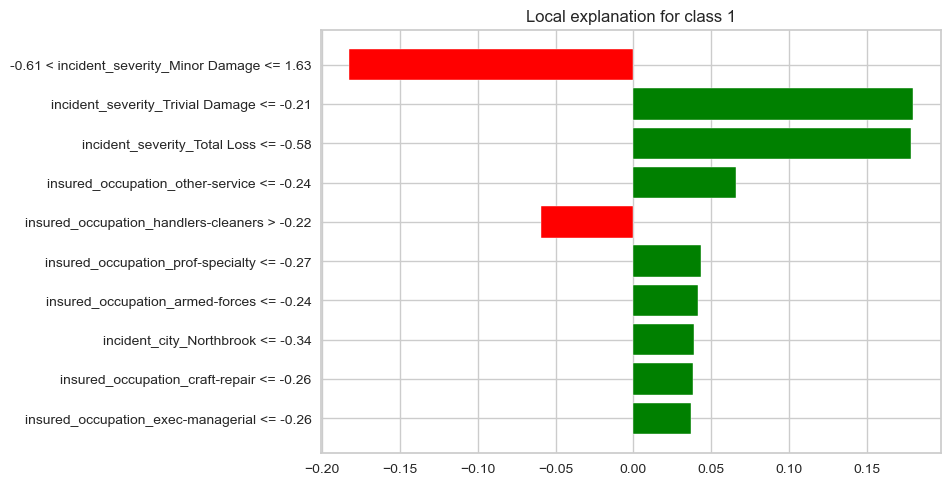

In [216]:
exp.as_pyplot_figure()

# DecisionTreeClassifier (CART)
CART stands for Classification And Regression Tree. It is a type of decision tree which can be used for both classification and regression tasks based on a non-parametric supervised learning method.

In [209]:
#pip install scikit-optimize

In [210]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.metrics import accuracy_score, \
                            precision_score, \
                            recall_score, \
                            f1_score, \
                            mean_squared_error, \
                            mean_absolute_error
from skopt import BayesSearchCV
from skopt.space import Real, Integer, Categorical
from scipy.stats import uniform, poisson

In [211]:
X_CART = pd.DataFrame(X_res)  # Independent variables
y_CART = pd.DataFrame(y_res)  # Dependent variable
 # Split dataset into training set and test set  # 70% training and 30% test
X_train, X_test, y_train, y_test = train_test_split(X_CART, y_CART, test_size=0.3, random_state=1)

In [212]:
# Create Decision Tree classifer object
CART = DecisionTreeClassifier(max_depth=2)  
# Train Decision Tree Classifer
CART = CART.fit(X_train,y_train) 
 
#Predict the response for test dataset 
y_pred = CART.predict(X_test) 
 
# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_pred)) 

Accuracy: 0.8181818181818182


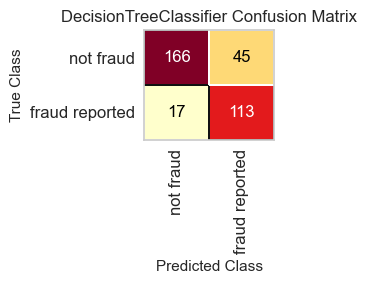

<Axes: title={'center': 'DecisionTreeClassifier Confusion Matrix'}, xlabel='Predicted Class', ylabel='True Class'>

In [213]:
fig, ax = plt.subplots(figsize=(3,3))
cm_viz = ConfusionMatrix(CART,
                        classes=['not fraud', 'fraud reported'],
                        label_encoder=mapping)
cm_viz.score(X_test, y_test)
cm_viz.poof()

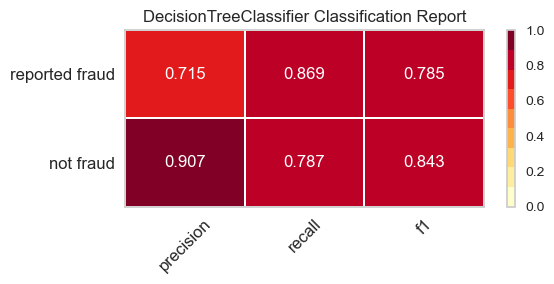

<Axes: title={'center': 'DecisionTreeClassifier Classification Report'}>

In [214]:
fig, ax = plt.subplots(figsize=(6,3))
cm_viz = ClassificationReport(CART,
                        classes=['not fraud', 'reported fraud'],
                        label_encoder=mapping)
cm_viz.score(X_test, y_test)
cm_viz.poof()

### K-Fold Cross Validation

In [215]:
from sklearn.model_selection import cross_validate
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, make_scorer
import time

In [216]:
## define the scoring metrics ##
scoring_metrics = {'accuracy' : make_scorer(accuracy_score), 
                   'precision': make_scorer(precision_score),
                   'recall': make_scorer(recall_score),
                   'f1': make_scorer(f1_score)}
                   
## run k-fold cross validation ##
start_time = time.time()
dcScores = cross_validate(CART,X_CART,y_CART,cv=10,scoring=scoring_metrics)
print('Time duration of K-fold CV computation: ',time.time()-start_time)

Time duration of K-fold CV computation:  0.4616575241088867


In [217]:
#report results
print('Mean accuracy: %.2f' % np.mean(dcScores['test_accuracy']))
print('Mean precision: %.2f' % np.mean(dcScores['test_precision']))
print('Mean recall: %.2f' % np.mean(dcScores['test_recall']))
print('Mean f1: %.2f' % np.mean(dcScores['test_f1']))

Mean accuracy: 0.79
Mean precision: 0.71
Mean recall: 0.83
Mean f1: 0.76


### Stratified K-Fold Cross Validation

In [218]:
from sklearn.model_selection import StratifiedKFold

In [219]:
## run stratified k-fold cross validation ##
start_time = time.time()
dcScores = cross_validate(CART,X_CART,y_CART,cv=StratifiedKFold(10),scoring=scoring_metrics)
print('Time duration of Stratified K-fold CV computation: ',time.time()-start_time)

Time duration of Stratified K-fold CV computation:  0.5117630958557129


In [220]:
#report results
print('Mean accuracy: %.2f' % np.mean(dcScores['test_accuracy']))
print('Mean precision: %.2f' % np.mean(dcScores['test_precision']))
print('Mean recall: %.2f' % np.mean(dcScores['test_recall']))
print('Mean f1: %.2f' % np.mean(dcScores['test_f1']))

Mean accuracy: 0.79
Mean precision: 0.71
Mean recall: 0.83
Mean f1: 0.76


### Hyperparameters Tunning
In Decision Trees, the parameters consist of the selected features 𝑓, and their associated split points 𝑠, which define how data propagate through the nodes in a tree. Some of the most common hyperparameters include:
Choice of splitting loss function, used to determine (𝑓,s) at a given node
Maximum depth of the tree, which sets a hard limit on how much branching can occur
Minimum number of samples for a split,  which places a lower bound on how much data must enter a node for it not to be considered a leaf node during training
Maximum number of leaf nodes, a value used to set an upper bound on the number of terminal points in the tree
To tune the hyperparameters, two methods are employed: Grid Search, as previously described, and Bayesian Serch.


#### GridSearchCV

In [221]:
import time
# setup parameter space
parameters = {'criterion':['gini','entropy'],
              'max_depth':np.arange(1,21).tolist()[0::2],
              'min_samples_split':np.arange(2,11).tolist()[0::2],
              'max_leaf_nodes':np.arange(3,26).tolist()[0::2]}

# create an instance of the grid search object
g1 = GridSearchCV(DecisionTreeClassifier(), parameters, cv=5, n_jobs=-1)

# conduct grid search over the parameter space
start_time = time.time()
g1.fit(X_train,y_train)
duration = time.time() - start_time

# show best parameter configuration found for classifier
cls_params1 = g1.best_params_
cls_params1

{'criterion': 'gini',
 'max_depth': 3,
 'max_leaf_nodes': 5,
 'min_samples_split': 2}

In [222]:
from sklearn.metrics import accuracy_score, \
                            precision_score, \
                            recall_score, \
                            f1_score, \
                            mean_squared_error, \
                            mean_absolute_error
# compute performance on test set
modelG1 = g1.best_estimator_
y_pred = modelG1.predict(X_test)
print('accuracy score: %.2f' % accuracy_score(y_test,y_pred))
print('precision score: %.2f' % precision_score(y_test,y_pred))
print('recall score: %.2f' % recall_score(y_test,y_pred))
print('f1 score: %.2f' % f1_score(y_test,y_pred))
print('computation time: %.2f' % duration)

accuracy score: 0.84
precision score: 0.75
recall score: 0.86
f1 score: 0.80
computation time: 50.11


#### BayesSearchCV
Here we build a probabilistic model to identify the best set of hyperparameters. The hyperparameter space is defined by statistical distributions. We can further influence how the tuning performs through a careful selection of prior distributions. This method is also computationally efficient, but it is more complex to use or explain when compared with Grid Search (Anon, 2023).

In [223]:
# setup parameter space
parameters = {'criterion': Categorical(['gini','entropy']),
              'max_depth': Integer(1,21,prior='log-uniform'),
              'min_samples_split': Real(1e-3,1.0,prior='log-uniform'),
              'max_leaf_nodes': Integer(3,26,prior='uniform')}
              
# create an instance of the bayesian search object
b1 = BayesSearchCV(DecisionTreeClassifier(), parameters, cv=5, n_iter=10, random_state=42, n_jobs=-1)

# conduct randomized search over the parameter space
start_time = time.time()
b1.fit(X_train,y_train)
duration = time.time() - start_time

# show best parameter configuration found for classifier
cls_params3 = b1.best_params_
cls_params3['min_samples_split'] = np.ceil(cls_params3['min_samples_split']*X_train.shape[0])
cls_params3

OrderedDict([('criterion', 'entropy'),
             ('max_depth', 16),
             ('max_leaf_nodes', 14),
             ('min_samples_split', 259.0)])

In [224]:
# compute performance on test set
modelB1 = b1.best_estimator_
y_pred = modelB1.predict(X_test)
print('accuracy score: %.2f' % accuracy_score(y_test,y_pred))
print('precision score: %.2f' % precision_score(y_test,y_pred))
print('recall score: %.2f' % recall_score(y_test,y_pred))
print('f1 score: %.2f' % f1_score(y_test,y_pred))
print('computation time: %.2f' % duration)

accuracy score: 0.84
precision score: 0.75
recall score: 0.86
f1 score: 0.80
computation time: 1.67


Given that both yield satisfactory metrics, I chose to utilize Bayes Search CV parameters due to their lower computational cost. 

### CART tunned

In [225]:
X_CART = pd.DataFrame(X_res)  # Independent variables
y_CART = pd.DataFrame(y_res)  # Dependent variable
 # Split dataset into training set and test set  # 70% training and 30% test
X_train, X_test, y_train, y_test = train_test_split(X_CART, y_CART, test_size=0.3, random_state=1)

In [226]:
# Create Decision Tree classifer object
CART = DecisionTreeClassifier(max_depth=16, criterion='entropy', max_leaf_nodes=14, min_samples_split=259)  
# Train Decision Tree Classifer
CART = CART.fit(X_train,y_train) 
 
#Predict the response for test dataset 
y_pred_CART = CART.predict(X_test) 
 
# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_pred_CART)) 

Accuracy: 0.8387096774193549


In [227]:
CART_test_acc = accuracy_score(y_test, y_pred_CART)
CART_test_prec = precision_score(y_test,y_pred_CART)
CART_test_recall = recall_score(y_test,y_pred_CART)
CART_test_f1_score = f1_score(y_test,y_pred_CART)

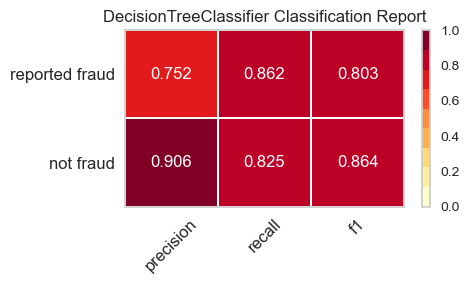

<Axes: title={'center': 'DecisionTreeClassifier Classification Report'}>

In [228]:
fig, ax = plt.subplots(figsize=(5,3))
cm_viz = ClassificationReport(CART,
                        classes=['not fraud', 'reported fraud'],
                        label_encoder=mapping)
cm_viz.score(X_test, y_test)
cm_viz.poof()

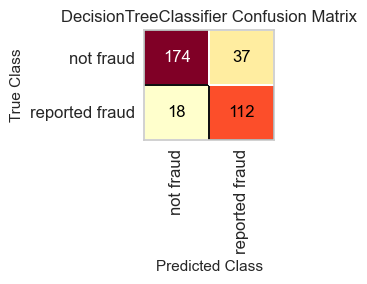

<Axes: title={'center': 'DecisionTreeClassifier Confusion Matrix'}, xlabel='Predicted Class', ylabel='True Class'>

In [229]:
fig, ax = plt.subplots(figsize=(3,3))
cm_viz = ConfusionMatrix(CART,
                        classes=['not fraud', 'reported fraud'],
                        label_encoder=mapping)
cm_viz.score(X_test, y_test)
cm_viz.poof()

In [230]:
print(classification_report(y_test, y_pred_CART, target_names=target_names))

                precision    recall  f1-score   support

      No Fraud       0.91      0.82      0.86       211
Fraud reported       0.75      0.86      0.80       130

      accuracy                           0.84       341
     macro avg       0.83      0.84      0.83       341
  weighted avg       0.85      0.84      0.84       341



In [231]:
## run stratified k-fold cross validation ##
start_time = time.time()
dcScores = cross_validate(CART,X_CART,y_CART,cv=StratifiedKFold(10),scoring=scoring_metrics)
print('Time duration of Stratified K-fold CV computation: ',time.time()-start_time)

Time duration of Stratified K-fold CV computation:  0.4727168083190918


In [232]:
#report results
print('Mean accuracy: %.2f' % np.mean(dcScores['test_accuracy']))
print('Mean precision: %.2f' % np.mean(dcScores['test_precision']))
print('Mean recall: %.2f' % np.mean(dcScores['test_recall']))
print('Mean f1: %.2f' % np.mean(dcScores['test_f1']))

Mean accuracy: 0.83
Mean precision: 0.79
Mean recall: 0.80
Mean f1: 0.79


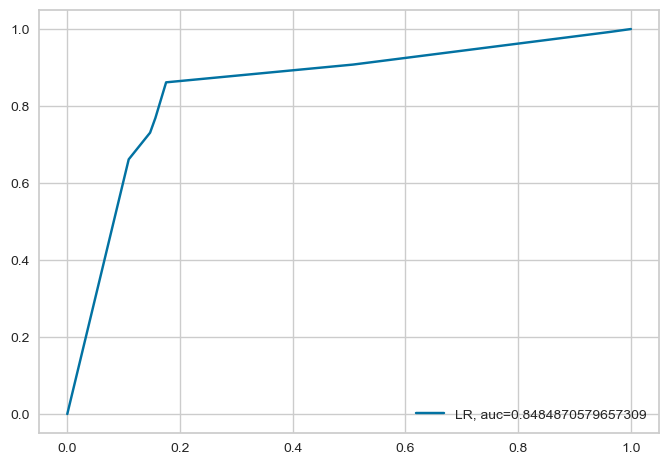

In [233]:
y_pred_CART_proba = CART.predict_proba(X_test)[::,1]
fpr, tpr, _ = metrics.roc_curve(y_test,  y_pred_CART_proba)
auc = metrics.roc_auc_score(y_test, y_pred_CART_proba)
plt.plot(fpr,tpr,label="LR, auc="+str(auc))
plt.legend(loc=4)
plt.show()

### Evaluating results using PyCaret

In [235]:
from pycaret.classification import *
exp_name_LDA = setup(data = X_res,  target = y_res)

# create model
dt_classification = create_model('dt', max_depth=16, criterion='entropy', max_leaf_nodes=14, min_samples_split=259)

# launch evaluate widget
evaluate_model(dt_classification)

,Description,Value
0,Session id,4963
1,Target,fraud_reported
2,Target type,Binary
3,Original data shape,"(1135, 36)"
4,Transformed data shape,"(1135, 36)"
5,Transformed train set shape,"(794, 36)"
6,Transformed test set shape,"(341, 36)"
7,Numeric features,35
8,Preprocess,True
9,Imputation type,simple


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8500,0.8372,0.7576,0.8621,0.8065,0.6848,0.6886
1,0.8000,0.8298,0.6970,0.7931,0.7419,0.5798,0.5830
2,0.8375,0.8372,0.8182,0.7941,0.8060,0.6662,0.6665
3,0.8500,0.8401,0.8788,0.7838,0.8286,0.6960,0.6996
4,0.8101,0.8195,0.8438,0.7297,0.7826,0.6156,0.6208
5,0.7468,0.7340,0.6875,0.6875,0.6875,0.4747,0.4747
6,0.8987,0.9036,0.8438,0.9000,0.8710,0.7878,0.7889
7,0.8608,0.8353,0.7576,0.8929,0.8197,0.7075,0.7138
8,0.8354,0.8304,0.8788,0.7632,0.8169,0.6688,0.6743


interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

### Lime CART

In [242]:
explainer_CART = lime.lime_tabular.LimeTabularExplainer(X_train.values, 
                                                   feature_names=X_train.columns, class_names=[0, 1], discretize_continuous=True)

In [243]:
# Select a specific instance for explanation
instance_idx = 125
exp = explainer_CART.explain_instance(X_test.loc[instance_idx].values, CART.predict_proba)
# Visualize the explanation
# print("The column analysis of ",X_test_ohe_outlier.iloc[instance_idx])
exp.show_in_notebook(show_table=True, show_all=False)

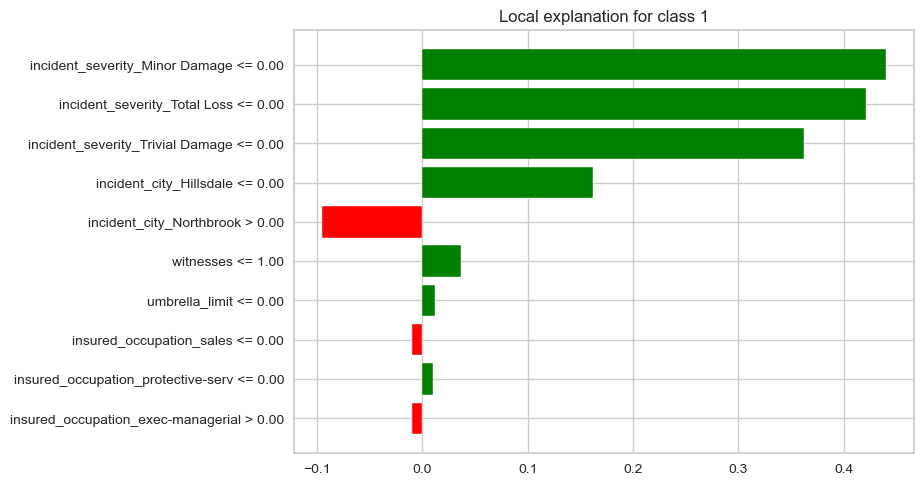

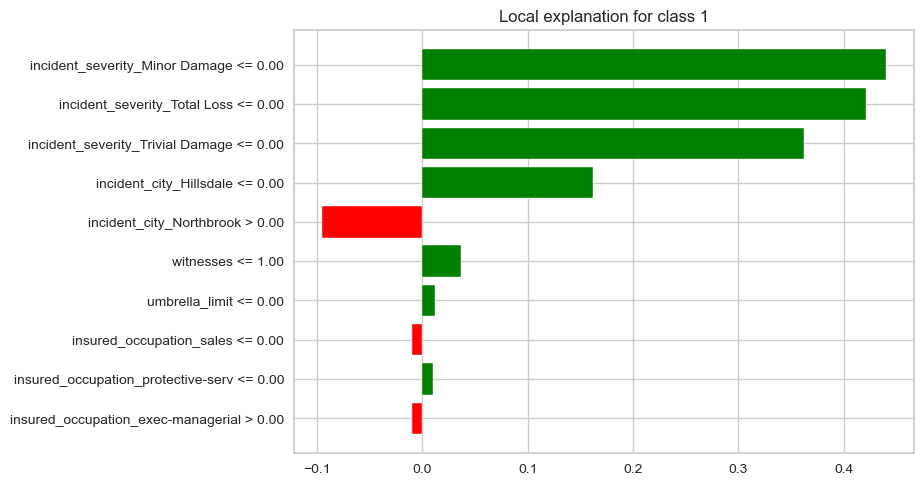

In [244]:
exp.as_pyplot_figure()

In [245]:
exp = explainer_CART.explain_instance(X_test.loc[629].values, CART.predict_proba)
# Visualize the explanation
# print("The column analysis of ",X_test_ohe_outlier.iloc[instance_idx])
exp.show_in_notebook(show_table=True, show_all=False)

Above is notable that “Incident severity Minor Damage” has a strong weight regards the predicted class. Therefore as an example, I created a data frame with the same variables, except for “Incident severity Minor Damage”, which was changed to “0” and interestingly it is predicted as fraudulent:

In [246]:
y_test.loc[629]

fraud_reported    0
Name: 629, dtype: int32

In [247]:
example1 = {
     'months_as_customer': [254],
    'age': [41],
    'policy_deductable': [500],
    'umbrella_limit': [5000000],
    'insured_sex': [0],
    'number_of_vehicles_involved': [1],
    'property_damage': [1],
    'bodily_injuries': [2],
    'witnesses': [2],
    'total_claim_amount': [63470],
    'injury_claim': [5770],
    'property_claim': [11540],
    'vehicle_claim': [46160],
    'insured_occupation_armed-forces': [0],
    'insured_occupation_craft-repair': [0],
    'insured_occupation_exec-managerial': [0],
    'insured_occupation_farming-fishing': [0],
    'insured_occupation_handlers-cleaners': [1],
    'insured_occupation_machine-op-inspct': [0],
    'insured_occupation_other-service': [0],
    'insured_occupation_priv-house-serv': [0],
    'insured_occupation_prof-specialty': [0],
    'insured_occupation_protective-serv': [0],
    'insured_occupation_sales': [0],
    'insured_occupation_tech-support': [0],
    'insured_occupation_transport-moving': [0],
    'incident_severity_Minor Damage': [0],  ### Change
    'incident_severity_Total Loss': [0],
    'incident_severity_Trivial Damage': [0],
    'incident_city_Columbus': [0],
    'incident_city_Hillsdale': [0],
    'incident_city_Northbend': [0],
    'incident_city_Northbrook': [1],
    'incident_city_Riverwood': [0],
    'incident_city_Springfield': [0]
}

data_test = pd.DataFrame(example1)
data_test.head()

,months_as_customer,age,policy_deductable,umbrella_limit,insured_sex,number_of_vehicles_involved,property_damage,bodily_injuries,witnesses,total_claim_amount,...,insured_occupation_transport-moving,incident_severity_Minor Damage,incident_severity_Total Loss,incident_severity_Trivial Damage,incident_city_Columbus,incident_city_Hillsdale,incident_city_Northbend,incident_city_Northbrook,incident_city_Riverwood,incident_city_Springfield
0,254,41,500,5000000,0,1,1,2,2,63470,...,0,0,0,0,0,0,0,1,0,0


In [248]:
CART.predict(data_test)

array([1])

In [249]:
exp = explainer_CART.explain_instance(data_test.loc[0].values, CART.predict_proba)
# Visualize the explanation
# print("The column analysis of ",X_test_ohe_outlier.iloc[instance_idx])
exp.show_in_notebook(show_table=True, show_all=False)

# Models Comparison

In [250]:
models_comparison = pd.DataFrame({
    'Model' : ['LogisticRegression','SVM', 'LDA', 'CART'],
    'Accuracy' : [LR_test_acc, SVC_test_acc, LDA_test_acc, CART_test_acc,],
    'Precision' : [LR_test_prec, SVC_test_prec, LDA_test_prec, CART_test_prec,],
    'Recall' : [LR_test_recall, SVC_test_recall, LDA_test_recall, CART_test_recall,],
    'F1-Score' : [LR_test_f1_score, SVC_test_f1_score, LDA_test_f1_score, CART_test_f1_score,]
})

models_comparison.sort_values(by = 'Recall', ascending = False)

,Model,Accuracy,Precision,Recall,F1-Score
2,LDA,0.847507,0.760000,0.876923,0.814286
3,CART,0.838710,0.751678,0.861538,0.802867
1,SVM,0.838028,0.747899,0.847619,0.794643
0,LogisticRegression,0.838028,0.756522,0.828571,0.790909


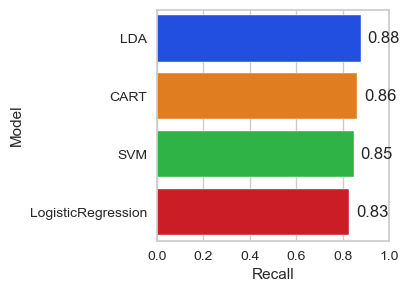

In [251]:
fig,ax = plt.subplots(figsize=(3,3))
barplot =sns.barplot(data=models_comparison,x='Recall', y='Model',palette='bright',order=models_comparison.sort_values('Recall',ascending=False).Model,ax=ax)
ax.set(xlim=(0,1))
for p in ax.patches:
    ax.annotate("%.2f" % p.get_width(), xy=(p.get_width(), p.get_y()+p.get_height()/2),
            xytext=(5, 0), textcoords='offset points', ha="left", va="center")

Analysing the metrics all the models achieved satisfactory results. 